In [20]:
# dds cloudapi for Grounding DINO 1.5
from dds_cloudapi_sdk import Config, Client, DetectionTask, TextPrompt, DetectionModel, DetectionTarget
import os
import cv2
import torch
import numpy as np
import supervision as sv
from PIL import Image
from sam2.build_sam import build_sam2_video_predictor, build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor 
from utils.track_utils import sample_points_from_masks
from utils.video_utils import create_video_from_images
import json


In [35]:

"""
Step 1: Environment settings and model initialization for SAM 2
"""
# use bfloat16 for the entire notebook
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

# init sam image predictor and video predictor model
sam2_checkpoint = "./checkpoints/sam2_hiera_large.pt"
model_cfg = "sam2_hiera_l.yaml"

video_predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint)
sam2_image_model = build_sam2(model_cfg, sam2_checkpoint)
image_predictor = SAM2ImagePredictor(sam2_image_model)

# `video_dir` a directory of JPEG frames with filenames like `<frame_index>.jpg`
video_dir = "notebooks/videos/pi"

# scan all the JPEG frame names in this directory
frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1].lower() in [".jpg", ".jpeg"]
]
frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))

# init video predictor state
inference_state = video_predictor.init_state(video_path=video_dir)

ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)

frame loading (JPEG): 100%|██████████| 372/372 [00:09<00:00, 37.93it/s]


## Step 2: Prompt Grounding DINO 1.5 with Cloud API for box coordinates

In [36]:

"""
Step 2: Prompt Grounding DINO 1.5 with Cloud API for box coordinates
"""
# prompt grounding dino to get the box coordinates on specific frame
img_path = os.path.join(video_dir, frame_names[ann_frame_idx])
image = Image.open(img_path)

# Step 1: initialize the config
token = "acb5ee944d3ff954cb5d2c38d1f5cab8"
config = Config(token)

# Step 2: initialize the client
client = Client(config)

In [37]:

# Step 3: run the task by DetectionTask class
# image_url = "https://algosplt.oss-cn-shenzhen.aliyuncs.com/test_files/tasks/detection/iron_man.jpg"
# if you are processing local image file, upload them to DDS server to get the image url
image_url = client.upload_file(img_path)

task = DetectionTask(
    image_url=image_url,
    prompts=[TextPrompt(text="cup.bowl.plate.chopstick.plastic bottle.spoon.fork.packet.container.foil packet.plastic container. transparent plastic packet.cardboard food container")],
    targets=[DetectionTarget.BBox],  # detect bbox
    model=DetectionModel.GDino1_5_Pro,  # detect with GroundingDino-1.5-Pro model
)

client.run_task(task)
result = task.result
objects = result.objects  # the list of detected objects

input_boxes = []
confidences = []
class_names = []

for idx, obj in enumerate(objects):
    input_boxes.append(obj.bbox)
    confidences.append(obj.score)
    class_names.append(obj.category)

input_boxes = np.array(input_boxes)

# prompt SAM image predictor to get the mask for the object
image_predictor.set_image(np.array(image.convert("RGB")))

# process the detection results
OBJECTS = class_names

ID_TO_OBJECTS = {i+1: obj for i, obj in enumerate(OBJECTS)}

# prompt SAM 2 image predictor to get the mask for the object
masks, scores, logits = image_predictor.predict(
    point_coords=None,
    point_labels=None,
    box=input_boxes,
    multimask_output=False,
)

# convert the mask shape to (n, H, W)
if masks.ndim == 3:
    masks = masks[None]
    scores = scores[None]
    logits = logits[None]
elif masks.ndim == 4:
    masks = masks.squeeze(1)

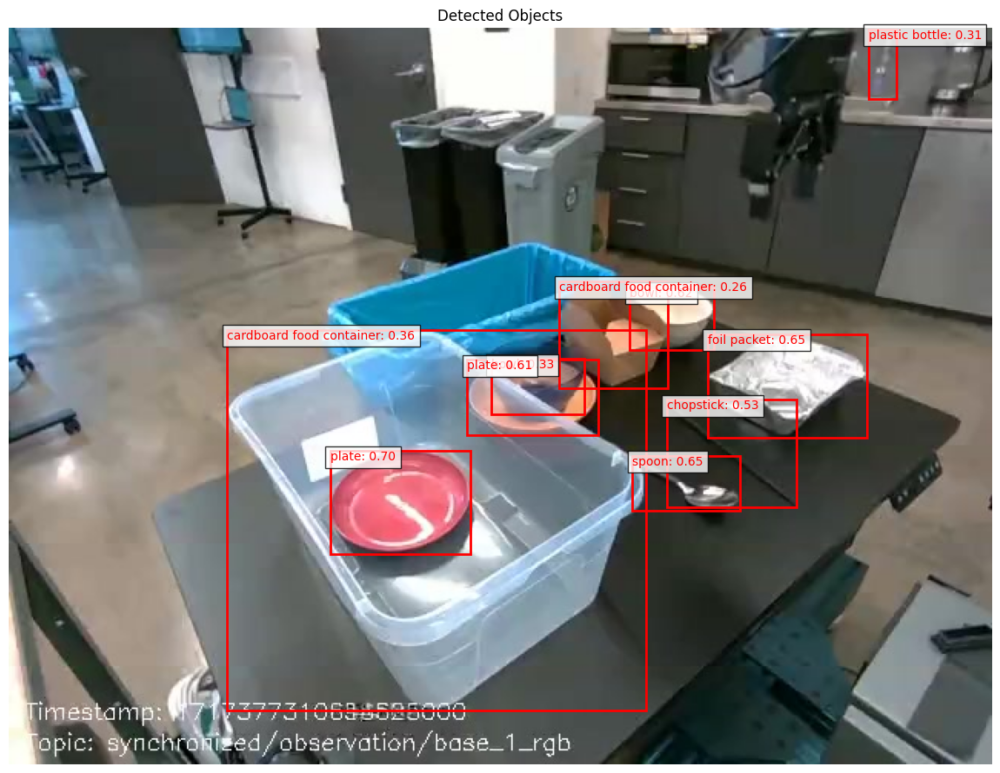

In [38]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

def plot_image_with_boxes(image_path, boxes, class_names, confidences):
    # Load the image
    image = Image.open(image_path)
    
    # Create figure and axes
    fig, ax = plt.subplots(1, figsize=(12, 9))
    
    # Display the image
    ax.imshow(image)
    
    # Create a Rectangle patch for each box
    for box, class_name, confidence in zip(boxes, class_names, confidences):
        x, y, w, h = box
        rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
        
        # Add the patch to the Axes
        ax.add_patch(rect)
        
        # Add label
        ax.text(x, y, f'{class_name}: {confidence:.2f}', 
                bbox=dict(facecolor='white', alpha=0.8),
                verticalalignment='top', color='red')

    plt.axis('off')
    plt.title('Detected Objects')
    plt.tight_layout()
    plt.show()

# Assuming you have the following variables from your previous code:
# img_path: path to your image
# input_boxes: numpy array of bounding boxes
# class_names: list of class names for each detected object
# confidences: list of confidence scores for each detected object

# Convert input_boxes to the format [x, y, width, height]
boxes_for_plot = []
for box in input_boxes:
    x1, y1, x2, y2 = box
    width = x2 - x1
    height = y2 - y1
    boxes_for_plot.append([x1, y1, width, height])

# Plot the image with bounding boxes
plot_image_with_boxes(img_path, boxes_for_plot, class_names, confidences)

Shape of masks: (10, 480, 640)
Data type: float32
Number of non-zero elements: 52393


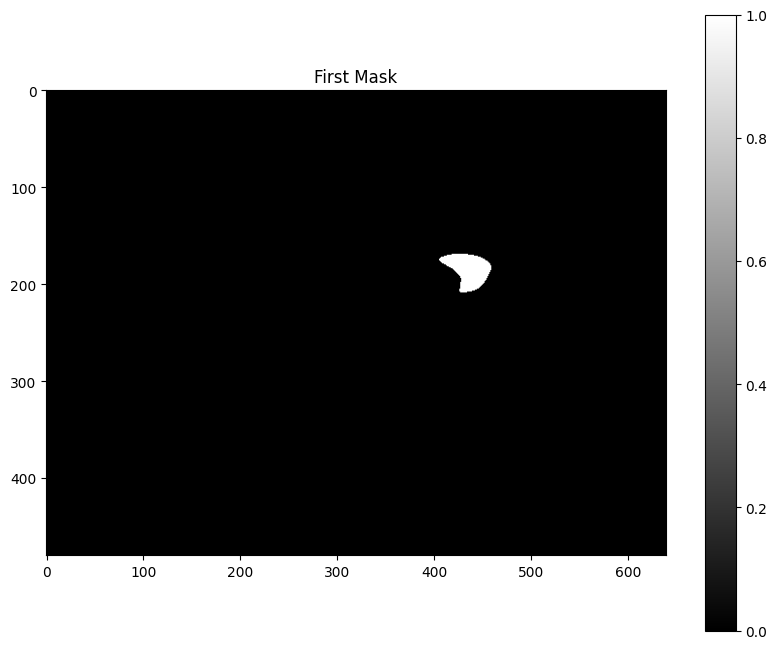

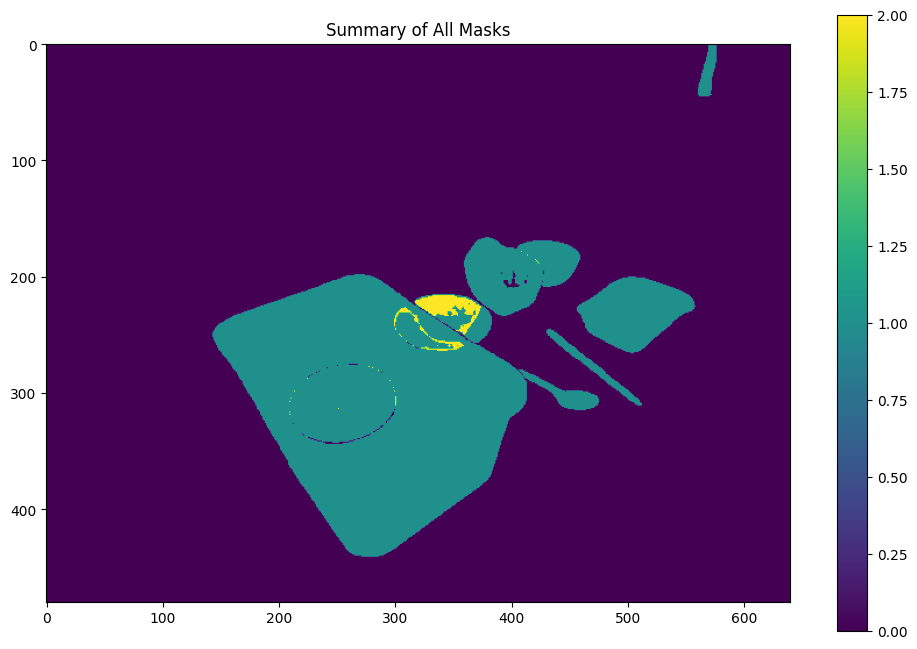

Mask 0:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0042, Std: 0.0644
  Non-zero pixels: 1278

Mask 1:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0039, Std: 0.0619
  Non-zero pixels: 1183

Mask 2:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0157, Std: 0.1242
  Non-zero pixels: 4812

Mask 3:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0068, Std: 0.0824
  Non-zero pixels: 2099

Mask 4:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0020, Std: 0.0450
  Non-zero pixels: 624

Mask 5:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0014, Std: 0.0373
  Non-zero pixels: 427

Mask 6:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0023, Std: 0.0483
  Non-zero pixels: 719

Mask 7:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0135, Std: 0.1154
  Non-zero pixels: 4150

Mask 8:
  Min: 0.0000, Max: 1.0000
  Mean: 0.1105, Std: 0.3135
  Non-zero pixels: 33933

Mask 9:
  Min: 0.0000, Max: 1.0000
  Mean: 0.0103, Std: 0.1010
  Non-zero pixels: 3168



In [39]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'masks' is your variable with shape (16, 480, 640)
print(f"Shape of masks: {masks.shape}")
print(f"Data type: {masks.dtype}")
print(f"Number of non-zero elements: {np.count_nonzero(masks)}")

# Visualize a single mask
def plot_mask(mask, title):
    plt.figure(figsize=(10, 8))
    plt.imshow(mask, cmap='gray')
    plt.title(title)
    plt.colorbar()
    plt.show()

# Plot the first mask
plot_mask(masks[0], "First Mask")

# Plot a summary of all masks
plt.figure(figsize=(12, 8))
plt.imshow(np.sum(masks, axis=0), cmap='viridis')
plt.title("Summary of All Masks")
plt.colorbar()
plt.show()

# Print statistics for each mask
for i in range(masks.shape[0]):
    mask = masks[i]
    print(f"Mask {i}:")
    print(f"  Min: {mask.min():.4f}, Max: {mask.max():.4f}")
    print(f"  Mean: {mask.mean():.4f}, Std: {mask.std():.4f}")
    print(f"  Non-zero pixels: {np.count_nonzero(mask)}")
    print()

## Step 3: Register each object's positive points to video predictor with separate add_new_points call


In [40]:
PROMPT_TYPE_FOR_VIDEO = "box"  # or "point" or "mask"

assert PROMPT_TYPE_FOR_VIDEO in ["point", "box", "mask"], "SAM 2 video predictor only support point/box/mask prompt"

# If you are using point prompts, we uniformly sample positive points based on the mask
if PROMPT_TYPE_FOR_VIDEO == "point":
    # sample the positive points from mask for each objects
    all_sample_points = sample_points_from_masks(masks=masks, num_points=10)
    for object_id, (label, points) in enumerate(zip(OBJECTS, all_sample_points), start=1):
        labels = np.ones((points.shape[0]), dtype=np.int32)
        _, out_obj_ids, out_mask_logits = video_predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=ann_frame_idx,
            obj_id=object_id,
            points=points,
            labels=labels,
        )
# Using box prompt
elif PROMPT_TYPE_FOR_VIDEO == "box":
    for object_id, (label, box) in enumerate(zip(OBJECTS, input_boxes), start=1):
        _, out_obj_ids, out_mask_logits = video_predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=ann_frame_idx,
            obj_id=object_id,
            box=box,
        )
# Using mask prompt is a more straightforward way
elif PROMPT_TYPE_FOR_VIDEO == "mask":
    for object_id, (label, mask) in enumerate(zip(OBJECTS, masks), start=1):
        labels = np.ones((1), dtype=np.int32)
        _, out_obj_ids, out_mask_logits = video_predictor.add_new_mask(
            inference_state=inference_state,
            frame_idx=ann_frame_idx,
            obj_id=object_id,
            mask=mask
        )
else:
    raise NotImplementedError("SAM 2 video predictor only support point/box/mask prompts")

## Step 4: Propagate the video predictor to get the segmentation results for each frame

In [41]:

def get_mask_coordinates(mask):
    return np.column_stack(np.where(mask))

video_segments = {}  # video_segments contains the per-frame segmentation results
mask_coordinates = {}  # To store mask coordinates for each frame and object
for out_frame_idx, out_obj_ids, out_mask_logits in video_predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }
    
    # Extract and store coordinates
    mask_coordinates[out_frame_idx] = {
        out_obj_id: get_mask_coordinates(video_segments[out_frame_idx][out_obj_id])
        for out_obj_id in out_obj_ids
    }

# Save mask coordinates to a file
with open('mask_coordinates.json', 'w') as f:
    json.dump({str(k): {str(k2): v2.tolist() for k2, v2 in v.items()} 
               for k, v in mask_coordinates.items()}, f)


propagate in video:   0%|          | 0/372 [00:00<?, ?it/s]

propagate in video: 100%|██████████| 372/372 [00:39<00:00,  9.36it/s]


## Step 5: Detect object movement and track significant movements


Structure of coordinates for frame 0, object 1:
[[  0 169 418]
 [  0 169 419]
 [  0 169 420]
 ...
 [  0 208 432]
 [  0 208 433]
 [  0 208 434]]
Shape: (1277, 3)


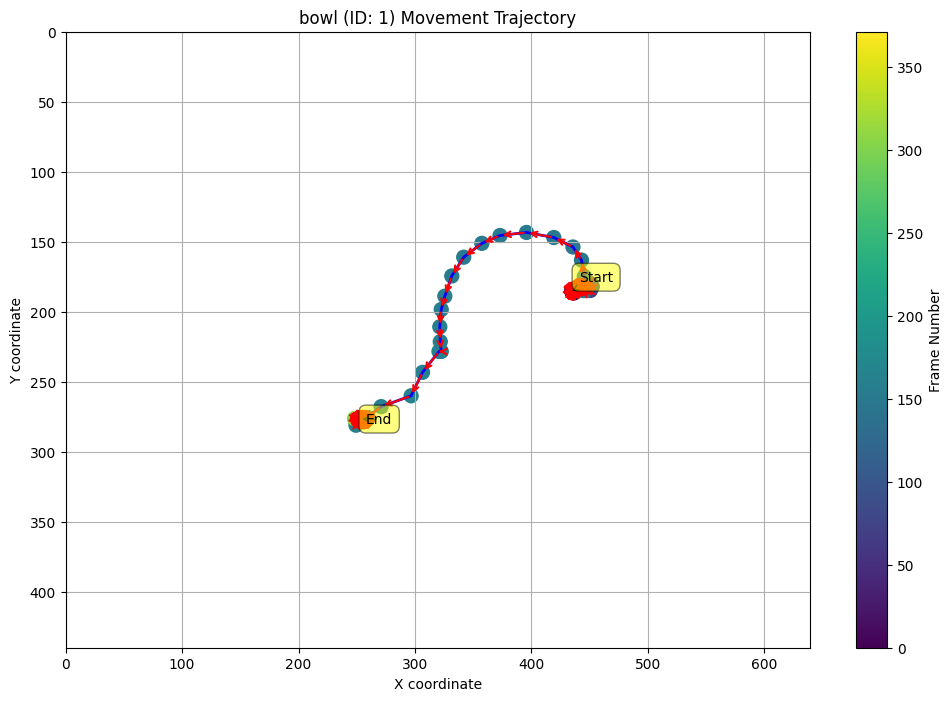


Movement summary for Object 1:
From frame 0 to 1: Moved 0.11 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.25 pixels
  Primarily upward movement
From frame 2 to 3: Moved 0.23 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.03 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.03 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.06 pixels
  Primarily downward movement
From frame 6 to 7: Moved 0.04 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.03 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.13 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.21 pixels
  Primarily downward movement
From frame 10 to 11: Moved 0.72 pixels
  Primarily downward movement
From frame 11 to 12: Moved 1.19 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.92 pixels
  Primarily rightward movement
From frame 13 to 14: Moved 1.65 pixels
  Primarily leftward movement
From frame 14 to 15:

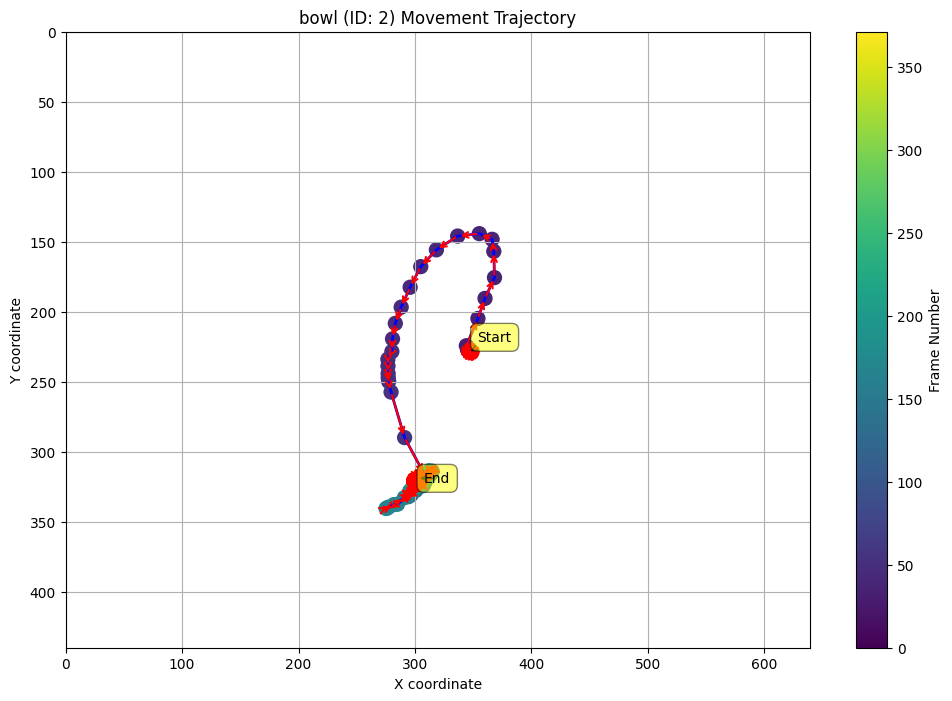


Movement summary for Object 2:
From frame 0 to 1: Moved 0.00 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.31 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.27 pixels
  Primarily rightward movement
From frame 3 to 4: Moved 0.35 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.02 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.02 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.06 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily leftward movement
From frame 9 to 10: Moved 0.02 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.09 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.01 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0.03 pixels
  Primarily rightward movement
From frame 13 to 14: Moved 0.04 pixels
  Primarily rightward movement
From frame 14 to 

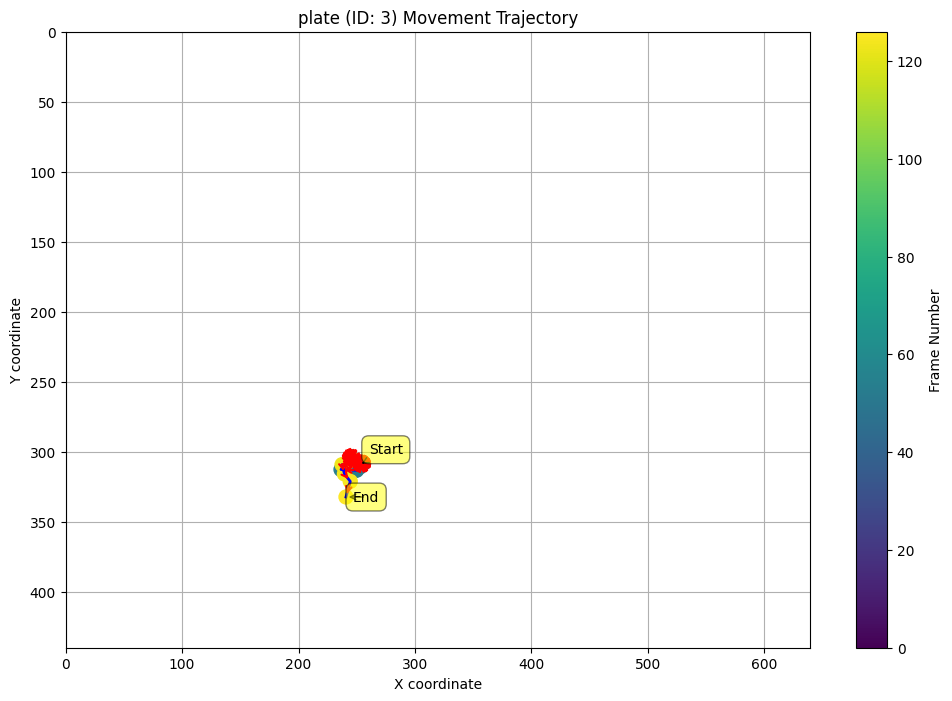


Movement summary for Object 3:
From frame 0 to 1: Moved 0.06 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.24 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.01 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.04 pixels
  Primarily downward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.03 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.05 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.05 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.01 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.03 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.44 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.03 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0.01 pixels
  Primarily leftward movement
From frame 13 to 14: Moved 0.24 pixels
  Primarily rightward movement
From frame 14 to 15:

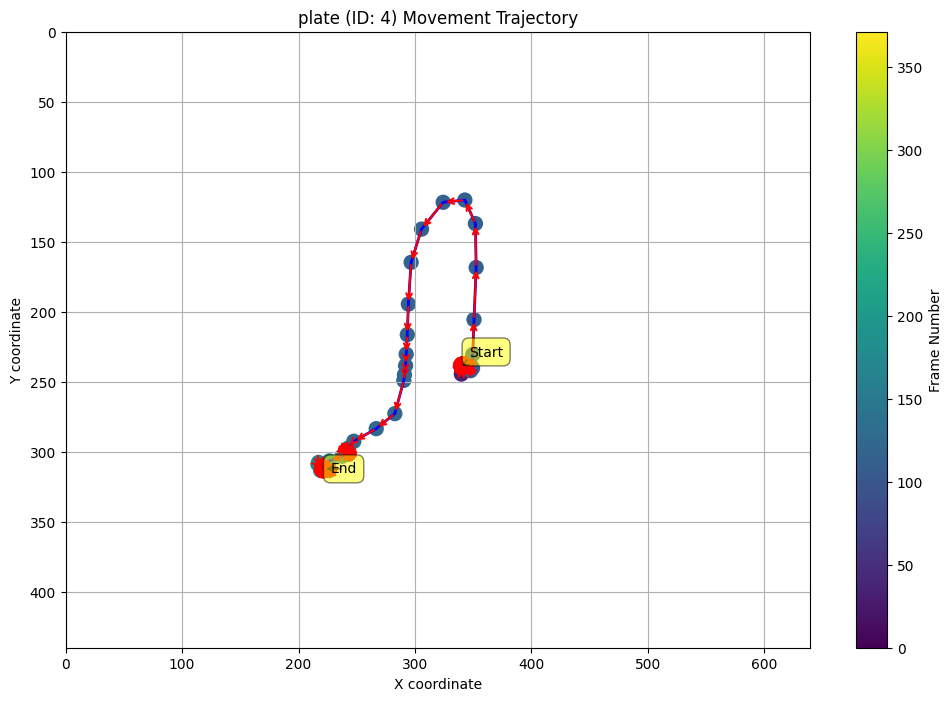


Movement summary for Object 4:
From frame 0 to 1: Moved 1.07 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.36 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.03 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.12 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.12 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.13 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.05 pixels
  Primarily downward movement
From frame 7 to 8: Moved 0.05 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.13 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.27 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.10 pixels
  Primarily downward movement
From frame 12 to 13: Moved 0.06 pixels
  Primarily rightward movement
From frame 13 to 14: Moved 0.10 pixels
  Primarily leftward movement
From frame 14 to 15:

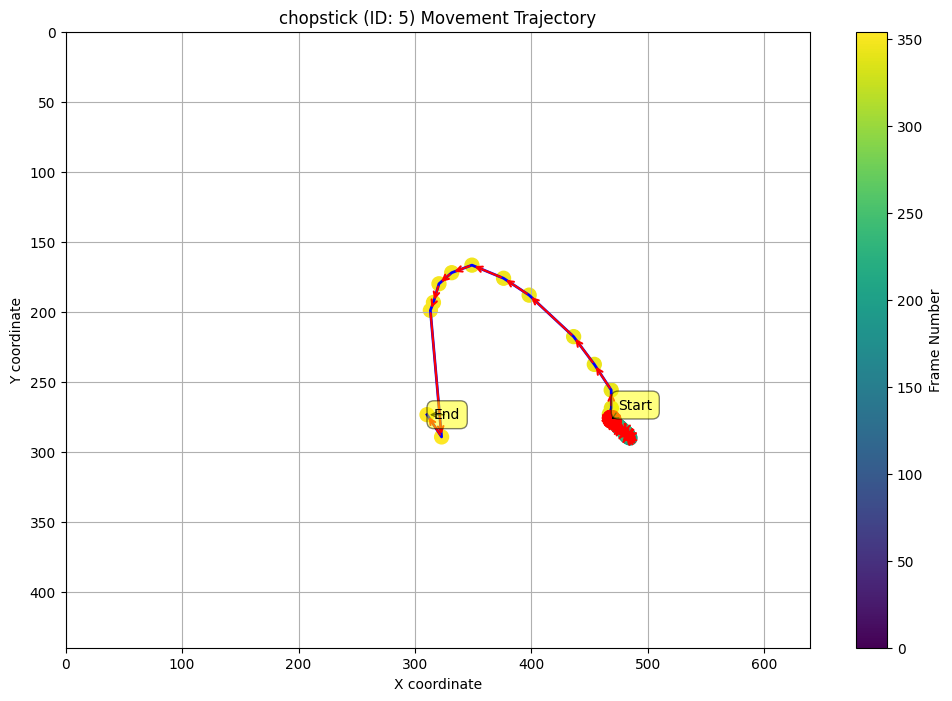


Movement summary for Object 5:
From frame 0 to 1: Moved 0.37 pixels
  Primarily downward movement
From frame 1 to 2: Moved 0.61 pixels
  Primarily rightward movement
From frame 2 to 3: Moved 0.10 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.13 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.09 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.22 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.06 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.11 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.12 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.11 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.07 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.05 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.10 pixels
  Primarily upward movement
From frame 13 to 14: Moved 0.10 pixels
  Primarily upward movement
From frame 14 to 15: M

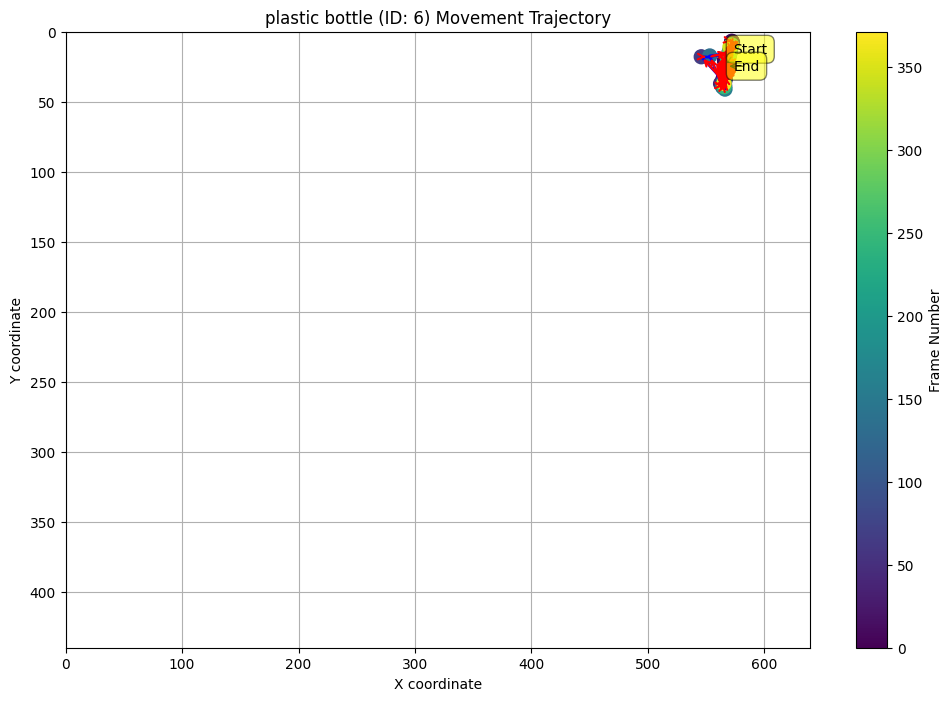


Movement summary for Object 6:
From frame 0 to 1: Moved 0.48 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.99 pixels
  Primarily upward movement
From frame 2 to 3: Moved 0.76 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.17 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.49 pixels
  Primarily upward movement
From frame 5 to 6: Moved 1.31 pixels
  Primarily downward movement
From frame 6 to 7: Moved 0.07 pixels
  Primarily upward movement
From frame 7 to 8: Moved 12.46 pixels
  Primarily downward movement
From frame 8 to 14: Moved 27.45 pixels
  Primarily upward movement
From frame 14 to 15: Moved 0.93 pixels
  Primarily leftward movement
From frame 15 to 16: Moved 0.23 pixels
  Primarily rightward movement
From frame 16 to 36: Moved 31.69 pixels
  Primarily downward movement
From frame 36 to 37: Moved 5.77 pixels
  Primarily upward movement
From frame 37 to 38: Moved 5.05 pixels
  Primarily upward movement
From frame 38 to 39: Moved 0.76

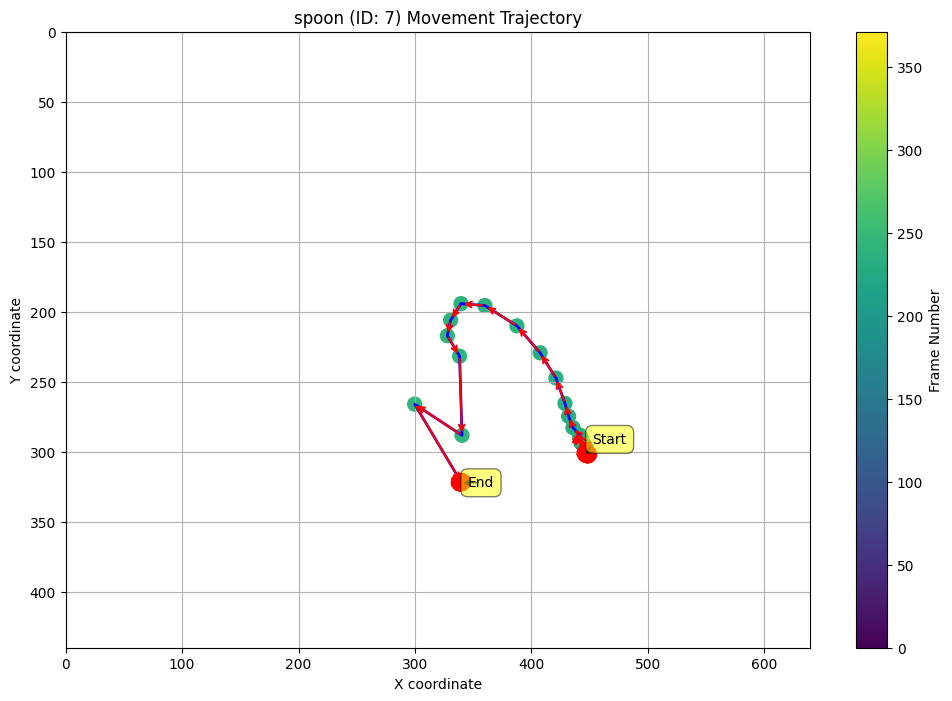


Movement summary for Object 7:
From frame 0 to 1: Moved 0.06 pixels
  Primarily leftward movement
From frame 1 to 2: Moved 0.03 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.01 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.06 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.06 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.30 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.10 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.03 pixels
  Primarily rightward movement
From frame 8 to 9: Moved 0.03 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.06 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.08 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.10 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.11 pixels
  Primarily leftward movement
From frame 13 to 14: Moved 0.11 pixels
  Primarily leftward movement
From frame 14 to 15: Mov

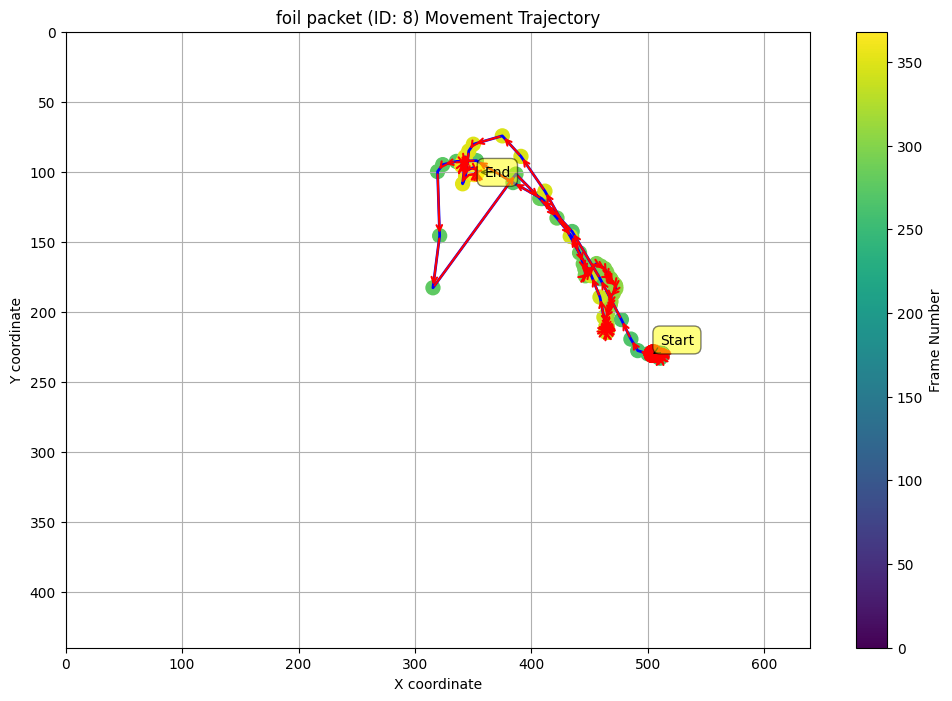


Movement summary for Object 8:
From frame 0 to 1: Moved 0.25 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.02 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.02 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily upward movement
From frame 5 to 6: Moved 0.07 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.02 pixels
  Primarily leftward movement
From frame 7 to 8: Moved 0.01 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.01 pixels
  Primarily leftward movement
From frame 9 to 10: Moved 0.01 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.08 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.07 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0.03 pixels
  Primarily rightward movement
From frame 13 to 14: Moved 0.05 pixels
  Primarily downward movement
From frame 14 to 15: Moved

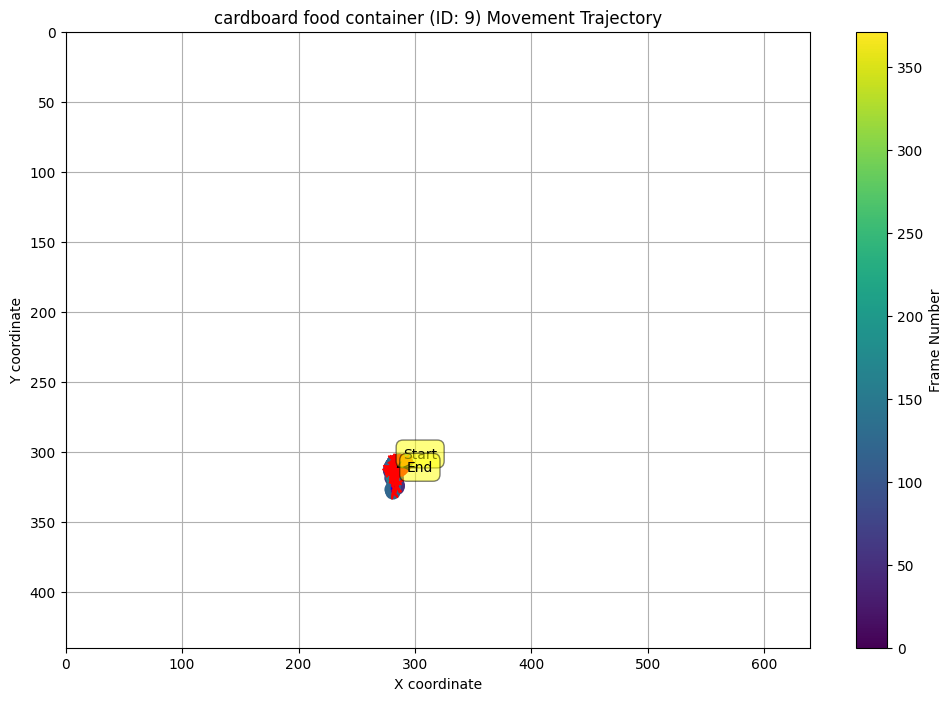


Movement summary for Object 9:
From frame 0 to 1: Moved 0.07 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.18 pixels
  Primarily rightward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.14 pixels
  Primarily downward movement
From frame 4 to 5: Moved 0.04 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.07 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.19 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.17 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.04 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.17 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.03 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.23 pixels
  Primarily downward movement
From frame 12 to 13: Moved 0.06 pixels
  Primarily upward movement
From frame 13 to 14: Moved 0.03 pixels
  Primarily downward movement
From frame 14 to 15: Moved 0.

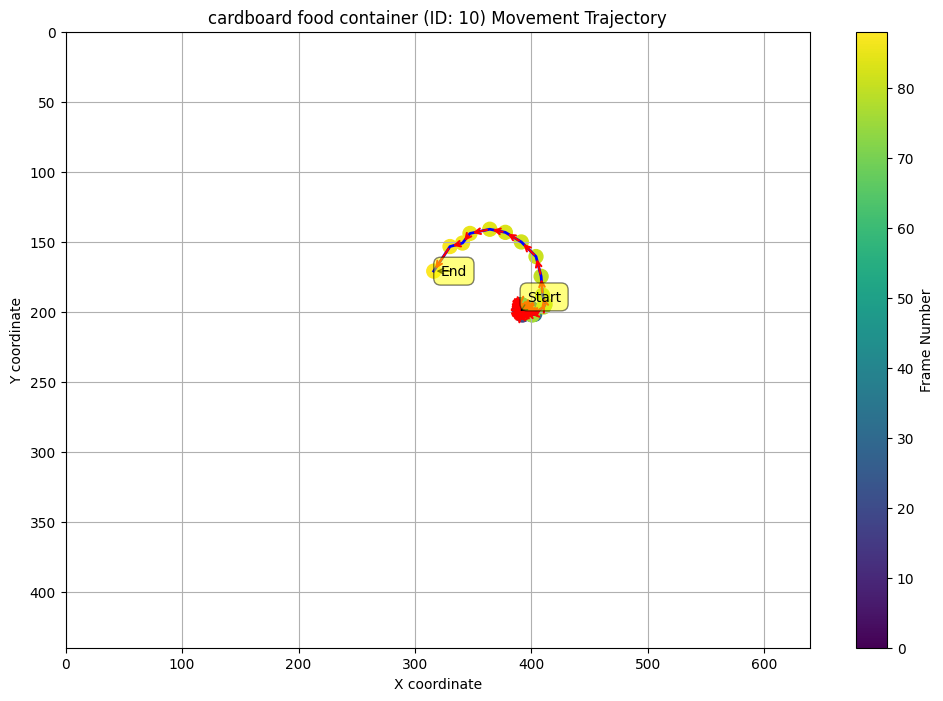


Movement summary for Object 10:
From frame 0 to 1: Moved 0.20 pixels
  Primarily downward movement
From frame 1 to 2: Moved 0.12 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.03 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.03 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.04 pixels
  Primarily upward movement
From frame 5 to 6: Moved 0.02 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.08 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.04 pixels
  Primarily upward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.03 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.04 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.11 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.81 pixels
  Primarily leftward movement
From frame 13 to 14: Moved 0.32 pixels
  Primarily downward movement
From frame 14 to 15: Moved

In [42]:
import numpy as np
import matplotlib.pyplot as plt
import json

# Load the mask coordinates
with open('mask_coordinates.json', 'r') as f:
    mask_coordinates = json.load(f)

# Convert string keys to integers
mask_coordinates = {int(k): {int(k2): np.array(v2) for k2, v2 in v.items()} 
                    for k, v in mask_coordinates.items()}

# Get unique object IDs
object_ids = set(obj_id for frame in mask_coordinates.values() for obj_id in frame)

# Debug: Print structure of mask_coordinates for the first frame and object
first_frame = min(mask_coordinates.keys())
first_obj = min(mask_coordinates[first_frame].keys())
print(f"Structure of coordinates for frame {first_frame}, object {first_obj}:")
print(mask_coordinates[first_frame][first_obj])
print(f"Shape: {mask_coordinates[first_frame][first_obj].shape}")

def get_centroid(coords):
    """Calculate the centroid of the coordinates."""
    if coords.size == 0:  # Handle empty array
        return None
    if coords.ndim == 1:  # Handle 1D array
        return coords[1:] if len(coords) > 2 else None
    return np.mean(coords[:, 1:], axis=0)  # For 2D array, ignore the first column (always 0)

# Determine the original image dimensions
max_y = max_x = 0
for frame in mask_coordinates.values():
    for obj in frame.values():
        if obj.size == 0:  # Skip empty arrays
            continue
        if obj.ndim == 1:
            if len(obj) > 2:
                max_y = max(max_y, obj[1])
                max_x = max(max_x, obj[2])
        else:
            max_y = max(max_y, np.max(obj[:, 1]))
            max_x = max(max_x, np.max(obj[:, 2]))

# Dictionary to map object IDs to names (you can modify this as needed)
object_names = {i: f"Object {i}" for i in object_ids}

for obj_id in object_ids:
    object_coords = {}
    for frame in sorted(mask_coordinates.keys()):
        if obj_id in mask_coordinates[frame]:
            centroid = get_centroid(mask_coordinates[frame][obj_id])
            if centroid is not None:
                object_coords[frame] = centroid

    if not object_coords:
        print(f"No valid coordinates for Object {obj_id}")
        continue

    # Extract x and y coordinates
    frames = list(object_coords.keys())
    y_coords = [coord[0] for coord in object_coords.values()]
    x_coords = [coord[1] for coord in object_coords.values()]

    plt.figure(figsize=(12, 8))
    
    # Plot trajectory
    plt.plot(x_coords, y_coords, 'b-', linewidth=2)
    plt.scatter(x_coords, y_coords, c=frames, cmap='viridis', s=100)
    
    # Add arrows to show direction
    for i in range(1, len(frames)):
        plt.annotate('', xy=(x_coords[i], y_coords[i]), xytext=(x_coords[i-1], y_coords[i-1]),
                     arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    # Annotate start and end points
    plt.annotate('Start', xy=(x_coords[0], y_coords[0]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='bottom',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))
    plt.annotate('End', xy=(x_coords[-1], y_coords[-1]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='top',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

    plt.colorbar(label='Frame Number')
    plt.title(f'{ID_TO_OBJECTS.get(obj_id, f"Unknown Object")} (ID: {obj_id}) Movement Trajectory')    
    plt.xlabel('X coordinate')
    plt.ylabel('Y coordinate')
    plt.xlim(0, max_x)
    plt.ylim(max_y, 0)  # Invert y-axis to match image coordinates
    plt.grid(True)
    plt.show()

    print(f"\nMovement summary for Object {obj_id}:")
    for i in range(1, len(frames)):
        dx = x_coords[i] - x_coords[i-1]
        dy = y_coords[i] - y_coords[i-1]
        distance = np.sqrt(dx**2 + dy**2)
        print(f"From frame {frames[i-1]} to {frames[i]}: Moved {distance:.2f} pixels")
        if abs(dx) > abs(dy):
            print(f"  Primarily {'rightward' if dx > 0 else 'leftward'} movement")
        else:
            print(f"  Primarily {'downward' if dy > 0 else 'upward'} movement")

    # Calculate total distance moved
    total_distance = np.sum([np.sqrt((x_coords[i]-x_coords[i-1])**2 + (y_coords[i]-y_coords[i-1])**2) 
                             for i in range(1, len(frames))])
    print(f"Total distance moved: {total_distance:.2f} pixels")

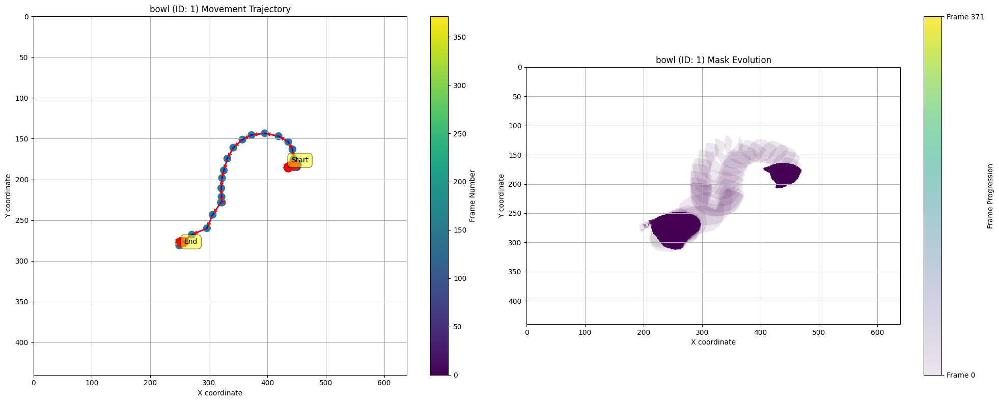


Movement and mask evolution summary for bowl (ID: 1):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 482.01 pixels
From frame 0 to 1: Moved 0.11 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.25 pixels
  Primarily upward movement
From frame 2 to 3: Moved 0.23 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.03 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.03 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.06 pixels
  Primarily downward movement
From frame 6 to 7: Moved 0.04 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.03 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.13 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.21 pixels
  Primarily downward movement
From frame 10 to 11: Moved 0.72 pixels
  Primarily downward movement
From frame 11 to 12: Moved 1.19 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.

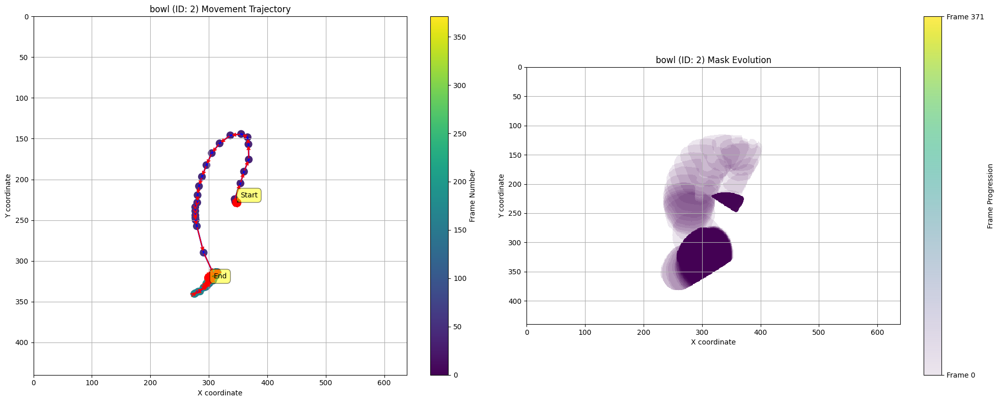


Movement and mask evolution summary for bowl (ID: 2):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 773.65 pixels
From frame 0 to 1: Moved 0.00 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.31 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.27 pixels
  Primarily rightward movement
From frame 3 to 4: Moved 0.35 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.02 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.02 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.06 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily leftward movement
From frame 9 to 10: Moved 0.02 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.09 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.01 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 

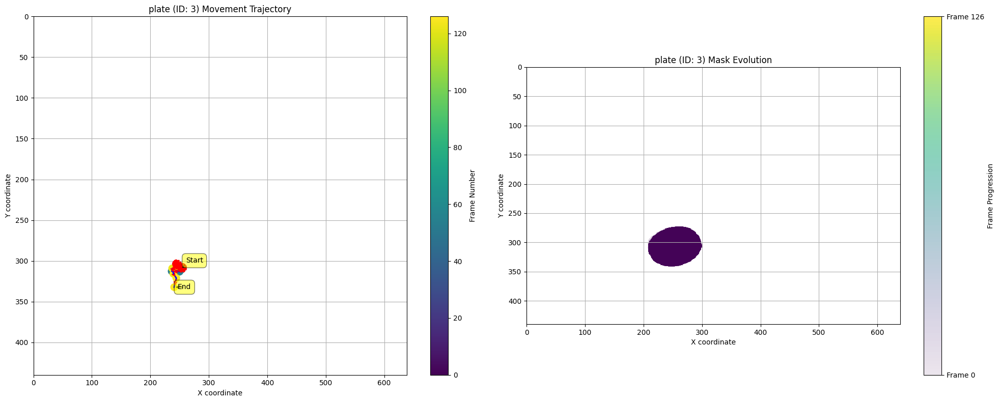


Movement and mask evolution summary for plate (ID: 3):
First appearance: Frame 0
Last appearance: Frame 126
Total frames: 127
Total distance moved: 85.95 pixels
From frame 0 to 1: Moved 0.06 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.24 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.01 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.04 pixels
  Primarily downward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.03 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.05 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.05 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.01 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.03 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.44 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.03 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0.

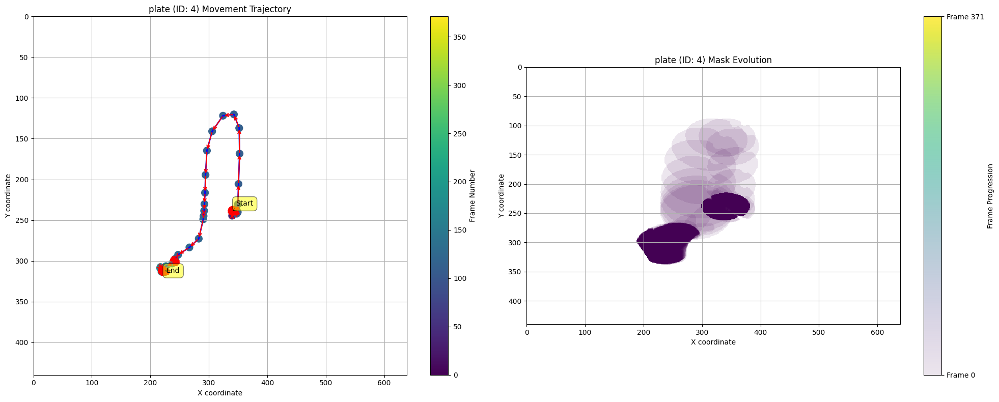


Movement and mask evolution summary for plate (ID: 4):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 509.53 pixels
From frame 0 to 1: Moved 1.07 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.36 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.03 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.12 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.12 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.13 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.05 pixels
  Primarily downward movement
From frame 7 to 8: Moved 0.05 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.13 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.27 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.10 pixels
  Primarily downward movement
From frame 12 to 13: Moved 0

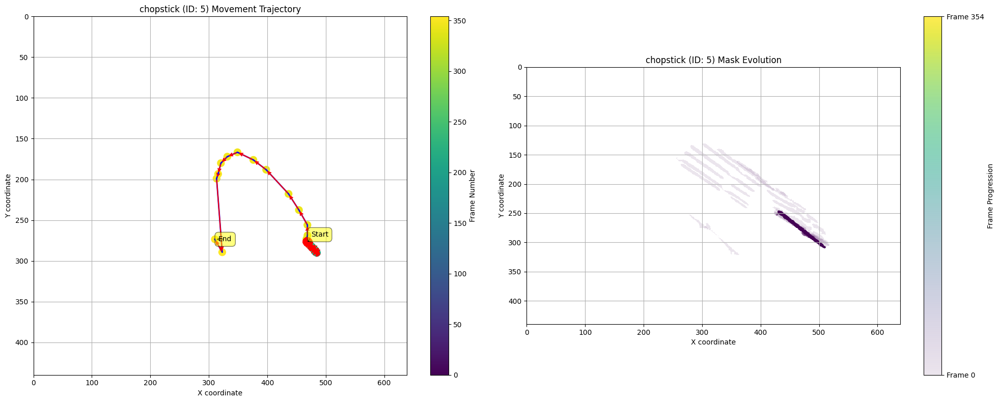


Movement and mask evolution summary for chopstick (ID: 5):
First appearance: Frame 0
Last appearance: Frame 354
Total frames: 354
Total distance moved: 537.29 pixels
From frame 0 to 1: Moved 0.37 pixels
  Primarily downward movement
From frame 1 to 2: Moved 0.61 pixels
  Primarily rightward movement
From frame 2 to 3: Moved 0.10 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.13 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.09 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.22 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.06 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.11 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.12 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.11 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.07 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.05 pixels
  Primarily rightward movement
From frame 12 to 13: 

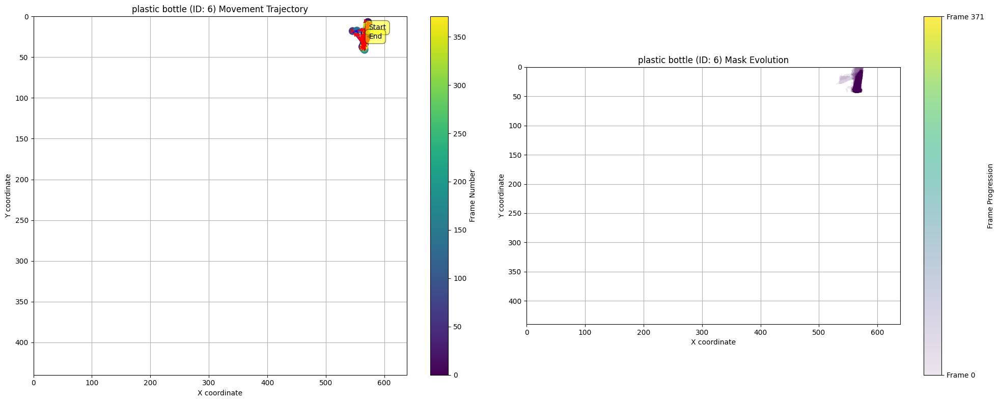


Movement and mask evolution summary for plastic bottle (ID: 6):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 265
Total distance moved: 623.40 pixels
From frame 0 to 1: Moved 0.48 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.99 pixels
  Primarily upward movement
From frame 2 to 3: Moved 0.76 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.17 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.49 pixels
  Primarily upward movement
From frame 5 to 6: Moved 1.31 pixels
  Primarily downward movement
From frame 6 to 7: Moved 0.07 pixels
  Primarily upward movement
From frame 7 to 8: Moved 12.46 pixels
  Primarily downward movement
From frame 8 to 14: Moved 27.45 pixels
  Primarily upward movement
From frame 14 to 15: Moved 0.93 pixels
  Primarily leftward movement
From frame 15 to 16: Moved 0.23 pixels
  Primarily rightward movement
From frame 16 to 36: Moved 31.69 pixels
  Primarily downward movement
From frame 36 to 37: Move

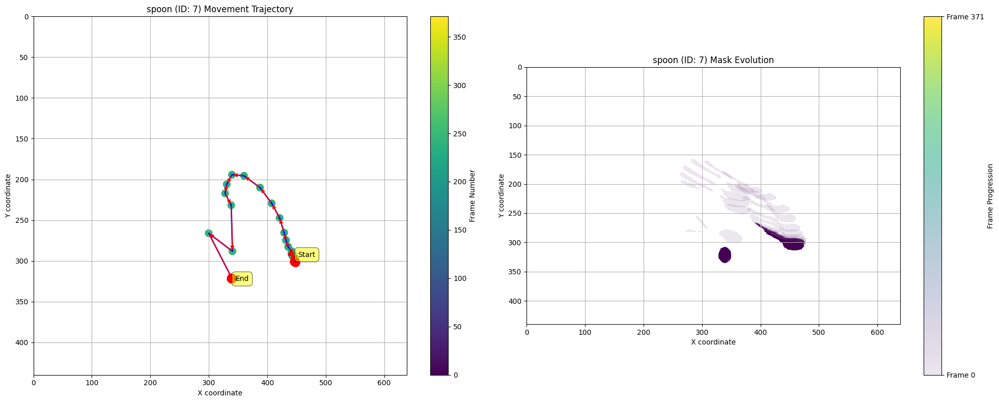


Movement and mask evolution summary for spoon (ID: 7):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 440.72 pixels
From frame 0 to 1: Moved 0.06 pixels
  Primarily leftward movement
From frame 1 to 2: Moved 0.03 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.01 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.06 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.06 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.30 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.10 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.03 pixels
  Primarily rightward movement
From frame 8 to 9: Moved 0.03 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.06 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.08 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.10 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.11

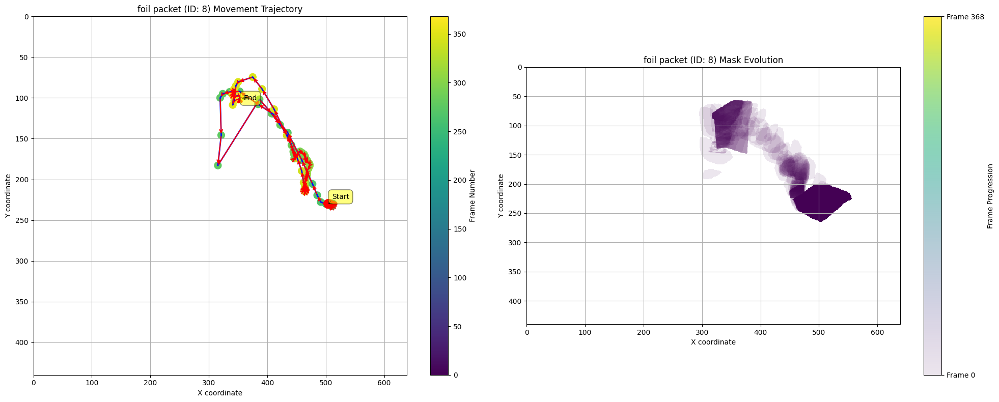


Movement and mask evolution summary for foil packet (ID: 8):
First appearance: Frame 0
Last appearance: Frame 368
Total frames: 365
Total distance moved: 935.39 pixels
From frame 0 to 1: Moved 0.25 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.02 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.02 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily upward movement
From frame 5 to 6: Moved 0.07 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.02 pixels
  Primarily leftward movement
From frame 7 to 8: Moved 0.01 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.01 pixels
  Primarily leftward movement
From frame 9 to 10: Moved 0.01 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.08 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.07 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0

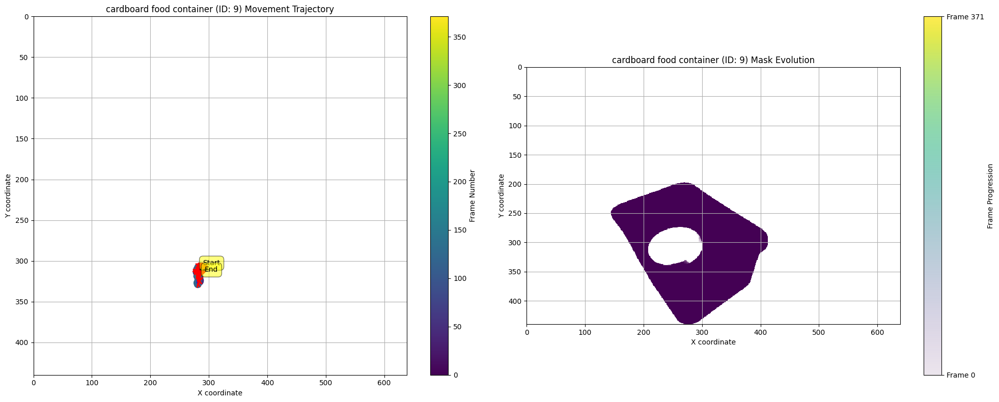


Movement and mask evolution summary for cardboard food container (ID: 9):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 191.79 pixels
From frame 0 to 1: Moved 0.07 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.18 pixels
  Primarily rightward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.14 pixels
  Primarily downward movement
From frame 4 to 5: Moved 0.04 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.07 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.19 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.17 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.04 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.17 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.03 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.23 pixels
  Primarily downward movement
From frame 12 t

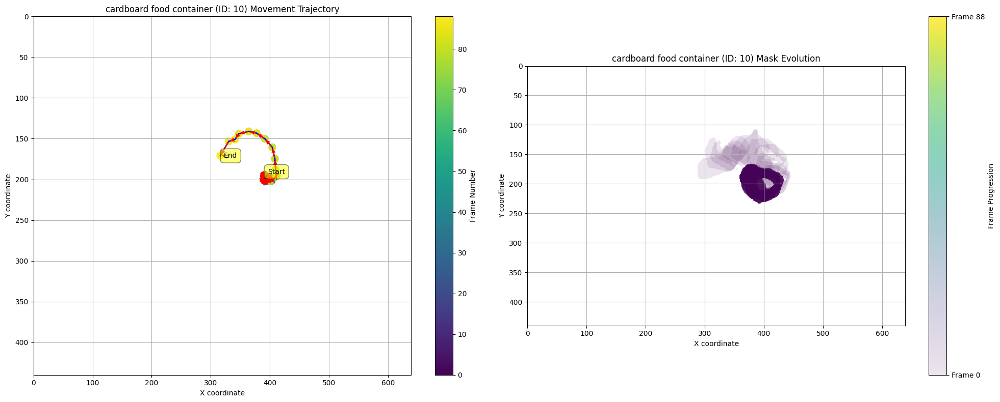


Movement and mask evolution summary for cardboard food container (ID: 10):
First appearance: Frame 0
Last appearance: Frame 88
Total frames: 89
Total distance moved: 212.86 pixels
From frame 0 to 1: Moved 0.20 pixels
  Primarily downward movement
From frame 1 to 2: Moved 0.12 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.03 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.03 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.04 pixels
  Primarily upward movement
From frame 5 to 6: Moved 0.02 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.08 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.04 pixels
  Primarily upward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.03 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.04 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.11 pixels
  Primarily rightward movement
From frame 12 to

In [43]:
import numpy as np
import matplotlib.pyplot as plt
import json
from matplotlib.colors import ListedColormap
from matplotlib.patches import Polygon

# Load the mask coordinates
with open('mask_coordinates.json', 'r') as f:
    mask_coordinates = json.load(f)

# Convert string keys to integers
mask_coordinates = {int(k): {int(k2): np.array(v2) for k2, v2 in v.items()} 
                    for k, v in mask_coordinates.items()}

# Get unique object IDs
object_ids = set(obj_id for frame in mask_coordinates.values() for obj_id in frame)


def get_centroid(coords):
    """Calculate the centroid of the coordinates."""
    if coords.size == 0:  # Handle empty array
        return None
    if coords.ndim == 1:  # Handle 1D array
        return coords[1:] if len(coords) > 2 else None
    return np.mean(coords[:, 1:], axis=0)  # For 2D array, ignore the first column (always 0)

# Determine the original image dimensions
max_y = max_x = 0
for frame in mask_coordinates.values():
    for obj in frame.values():
        if obj.size > 0:
            max_y = max(max_y, np.max(obj[:, 1]))
            max_x = max(max_x, np.max(obj[:, 2]))

def create_mask_image(coords, shape):
    mask = np.zeros(shape, dtype=np.uint8)
    if coords.size > 0:
        coords = coords[:, 1:]  # Remove the first column if it's all zeros
        rr, cc = coords[:, 0], coords[:, 1]
        mask[rr, cc] = 1
    return mask

for obj_id in object_ids:
    object_coords = {}
    for frame in sorted(mask_coordinates.keys()):
        if obj_id in mask_coordinates[frame]:
            centroid = get_centroid(mask_coordinates[frame][obj_id])
            if centroid is not None:
                object_coords[frame] = centroid

    if not object_coords:
        print(f"No valid coordinates for {ID_TO_OBJECTS.get(obj_id, f'Unknown Object')} (ID: {obj_id})")
        continue

    # Extract x and y coordinates
    frames = list(object_coords.keys())
    y_coords = [coord[0] for coord in object_coords.values()]
    x_coords = [coord[1] for coord in object_coords.values()]

    # Create a figure with two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
    
    # Plot trajectory on the left subplot
    ax1.plot(x_coords, y_coords, 'b-', linewidth=2)
    scatter = ax1.scatter(x_coords, y_coords, c=frames, cmap='viridis', s=100)
    
    # Add arrows to show direction
    for i in range(1, len(frames)):
        ax1.annotate('', xy=(x_coords[i], y_coords[i]), xytext=(x_coords[i-1], y_coords[i-1]),
                     arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    # Annotate start and end points
    ax1.annotate('Start', xy=(x_coords[0], y_coords[0]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='bottom',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))
    ax1.annotate('End', xy=(x_coords[-1], y_coords[-1]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='top',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

    plt.colorbar(scatter, ax=ax1, label='Frame Number')
    ax1.set_title(f'{ID_TO_OBJECTS.get(obj_id, "Unknown Object")} (ID: {obj_id}) Movement Trajectory')    
    ax1.set_xlabel('X coordinate')
    ax1.set_ylabel('Y coordinate')
    ax1.set_xlim(0, max_x)
    ax1.set_ylim(max_y, 0)  # Invert y-axis to match image coordinates
    ax1.grid(True)

    # Plot mask evolution on the right subplot
    ax2.set_xlim(0, max_x)
    ax2.set_ylim(max_y, 0)  # Invert y-axis to match image coordinates
    ax2.set_title(f'{ID_TO_OBJECTS.get(obj_id, "Unknown Object")} (ID: {obj_id}) Mask Evolution')
    ax2.set_xlabel('X coordinate')
    ax2.set_ylabel('Y coordinate')

    # Create a colormap that transitions from transparent to solid
    n_frames = len(frames)
    colors = plt.cm.viridis(np.linspace(0, 1, n_frames))
    colors[:, 3] = np.linspace(0.1, 0.8, n_frames)  # Adjust alpha values
    custom_cmap = ListedColormap(colors)

    # Plot masks for each frame
    for i, frame in enumerate(frames):
        coords = mask_coordinates[frame][obj_id]
        mask = create_mask_image(coords, (max_y+1, max_x+1))
        ax2.imshow(mask, cmap=custom_cmap, alpha=mask, vmin=0, vmax=n_frames, extent=[0, max_x, max_y, 0])

    # Add a colorbar for the mask evolution
    sm = plt.cm.ScalarMappable(cmap=custom_cmap, norm=plt.Normalize(vmin=0, vmax=n_frames-1))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax2, label='Frame Progression')
    cbar.set_ticks([0, n_frames-1])
    cbar.set_ticklabels([f'Frame {frames[0]}', f'Frame {frames[-1]}'])

    ax2.grid(True)

    plt.tight_layout()
    plt.show()

    print(f"\nMovement and mask evolution summary for {ID_TO_OBJECTS.get(obj_id, 'Unknown Object')} (ID: {obj_id}):")
    print(f"First appearance: Frame {frames[0]}")
    print(f"Last appearance: Frame {frames[-1]}")
    print(f"Total frames: {len(frames)}")

    # Calculate total distance moved
    total_distance = np.sum([np.sqrt((x_coords[i]-x_coords[i-1])**2 + (y_coords[i]-y_coords[i-1])**2) 
                             for i in range(1, len(frames))])
    print(f"Total distance moved: {total_distance:.2f} pixels")

    # Uncomment these lines if you want detailed movement summary
    for i in range(1, len(frames)):
        dx = x_coords[i] - x_coords[i-1]
        dy = y_coords[i] - y_coords[i-1]
        distance = np.sqrt(dx**2 + dy**2)
        print(f"From frame {frames[i-1]} to {frames[i]}: Moved {distance:.2f} pixels")
        if abs(dx) > abs(dy):
            print(f"  Primarily {'rightward' if dx > 0 else 'leftward'} movement")
        else:
            print(f"  Primarily {'downward' if dy > 0 else 'upward'} movement")

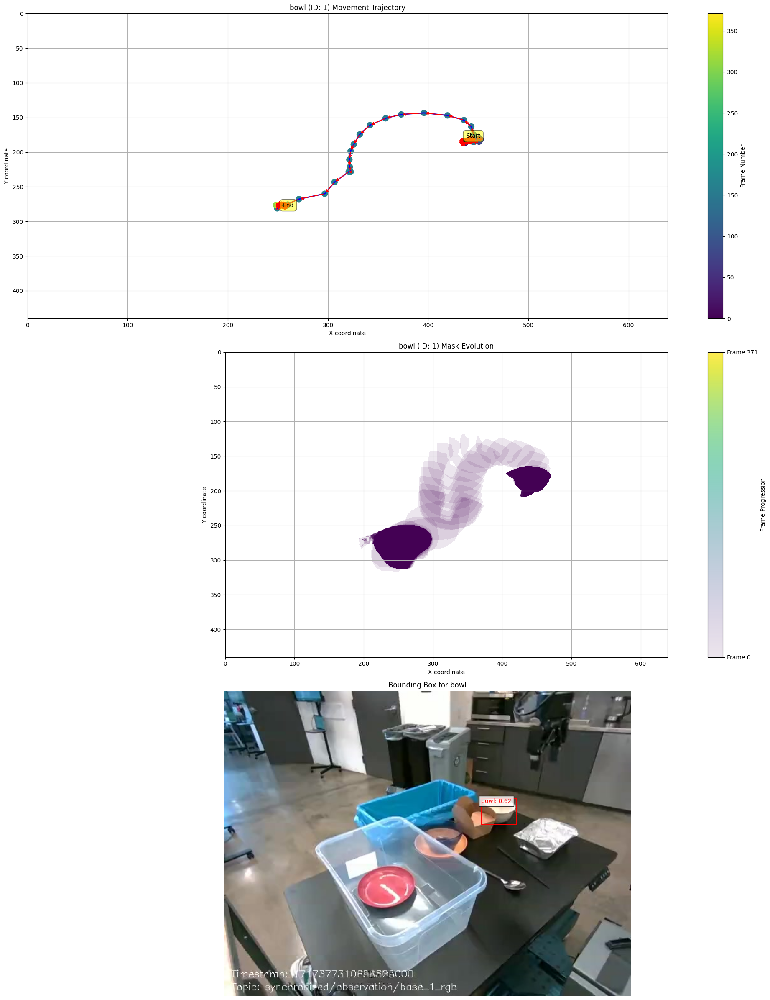


Movement and mask evolution summary for bowl (ID: 1):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 482.01 pixels


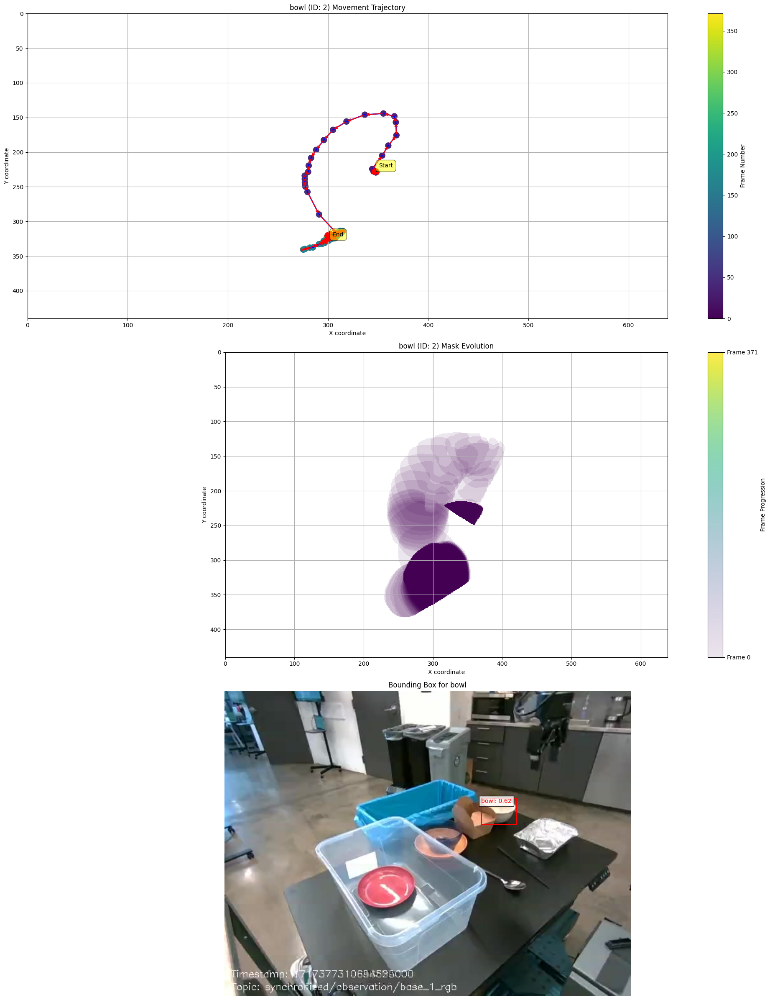


Movement and mask evolution summary for bowl (ID: 2):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 773.65 pixels


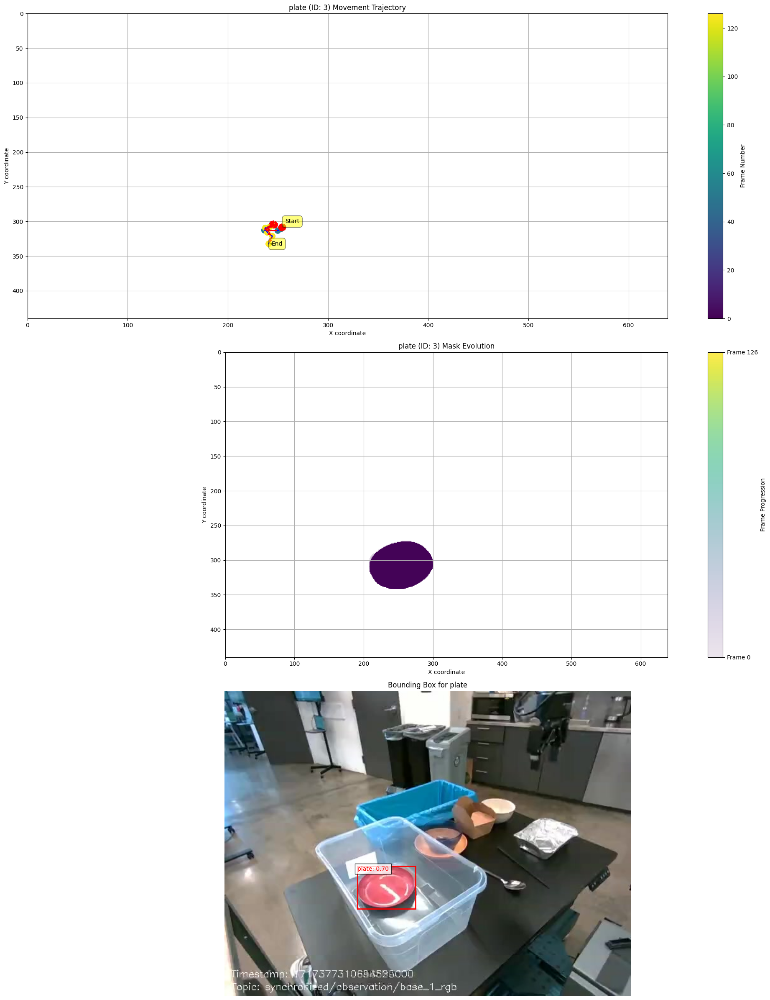


Movement and mask evolution summary for plate (ID: 3):
First appearance: Frame 0
Last appearance: Frame 126
Total frames: 127
Total distance moved: 85.95 pixels


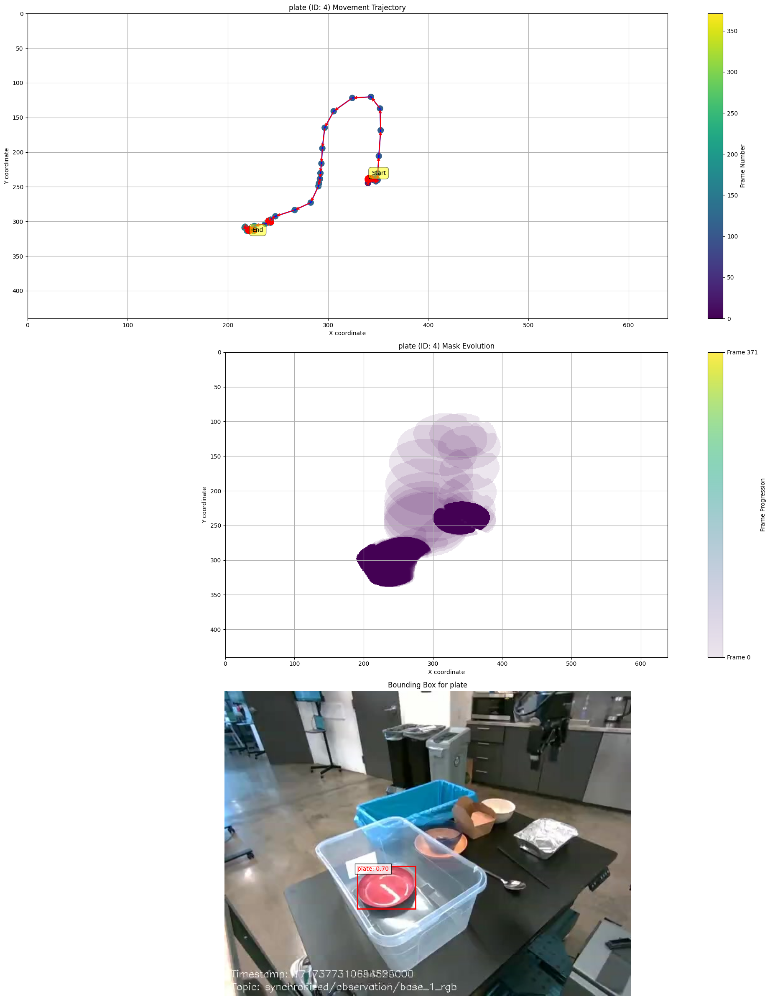


Movement and mask evolution summary for plate (ID: 4):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 509.53 pixels


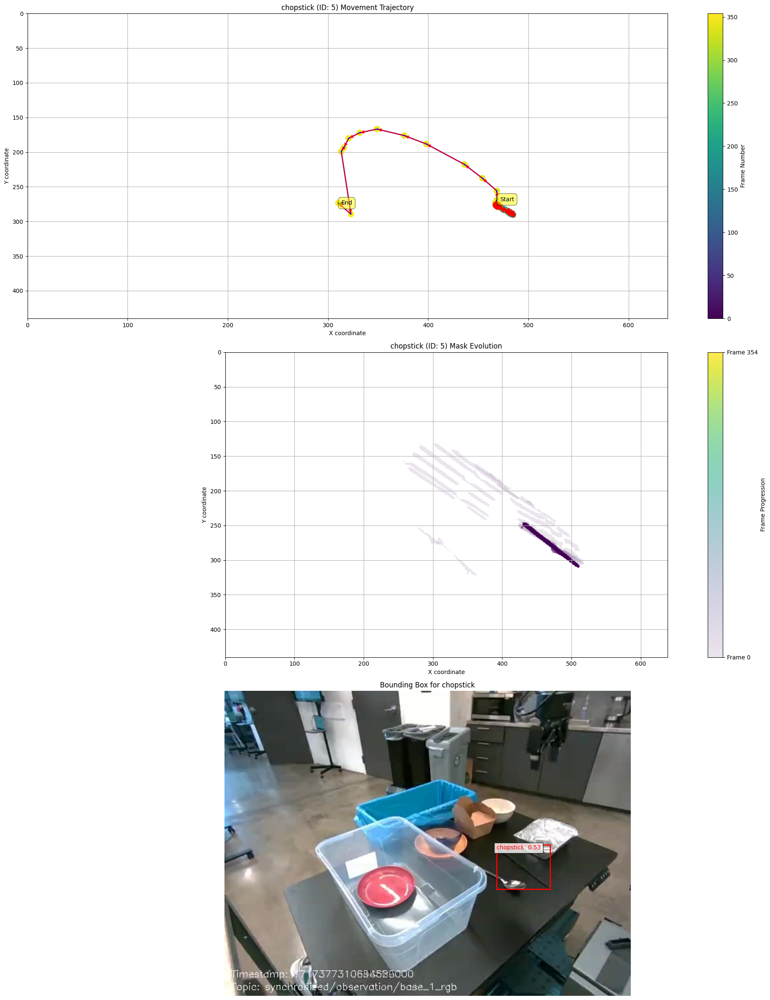


Movement and mask evolution summary for chopstick (ID: 5):
First appearance: Frame 0
Last appearance: Frame 354
Total frames: 354
Total distance moved: 537.29 pixels


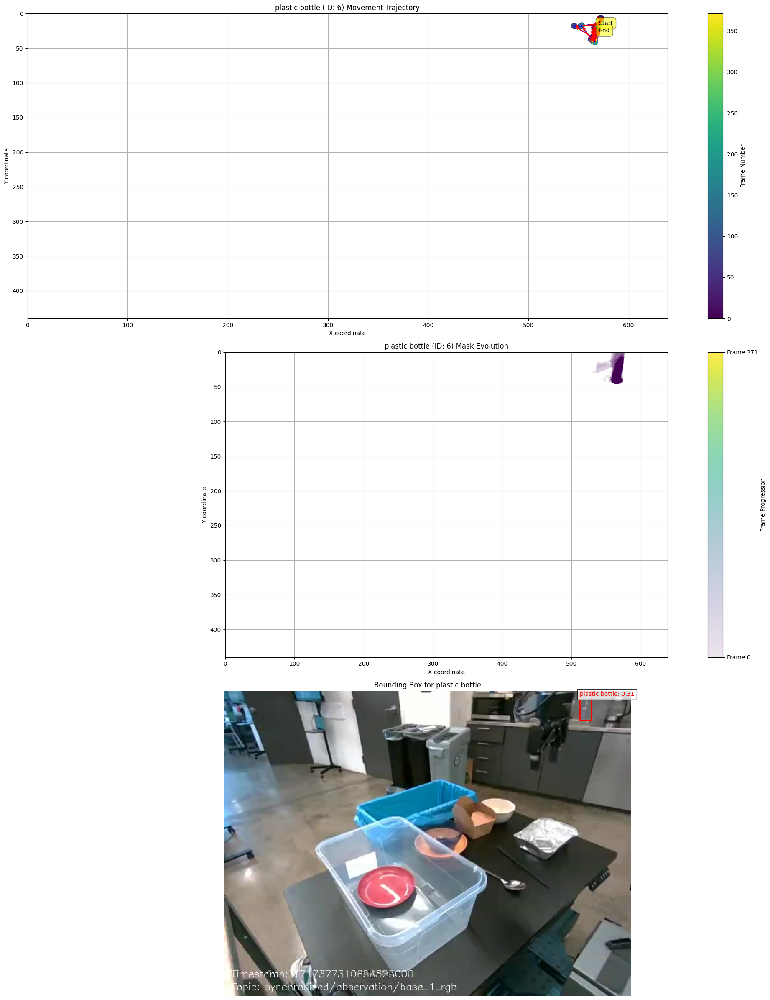


Movement and mask evolution summary for plastic bottle (ID: 6):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 265
Total distance moved: 623.40 pixels


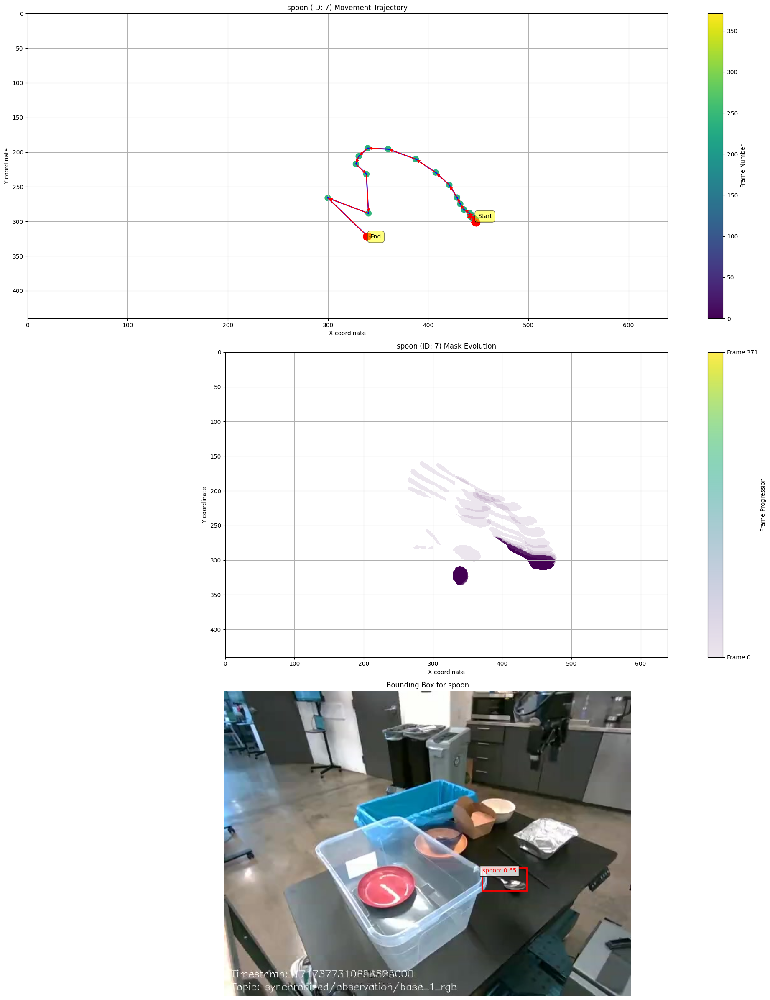


Movement and mask evolution summary for spoon (ID: 7):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 440.72 pixels


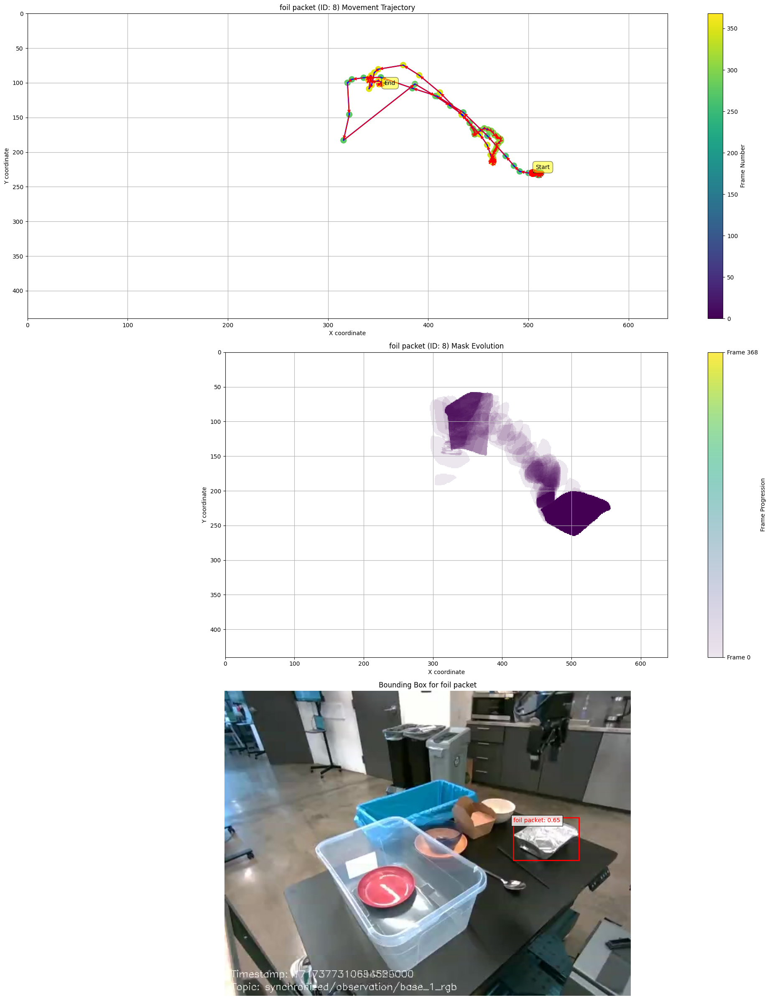


Movement and mask evolution summary for foil packet (ID: 8):
First appearance: Frame 0
Last appearance: Frame 368
Total frames: 365
Total distance moved: 935.39 pixels


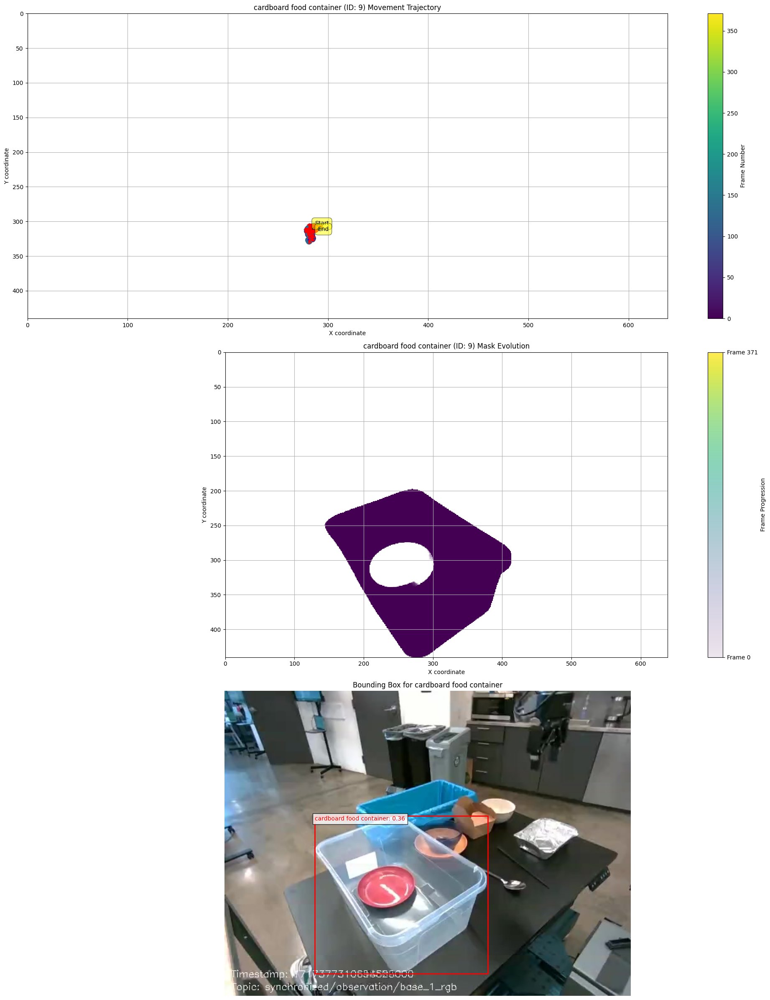


Movement and mask evolution summary for cardboard food container (ID: 9):
First appearance: Frame 0
Last appearance: Frame 371
Total frames: 372
Total distance moved: 191.79 pixels


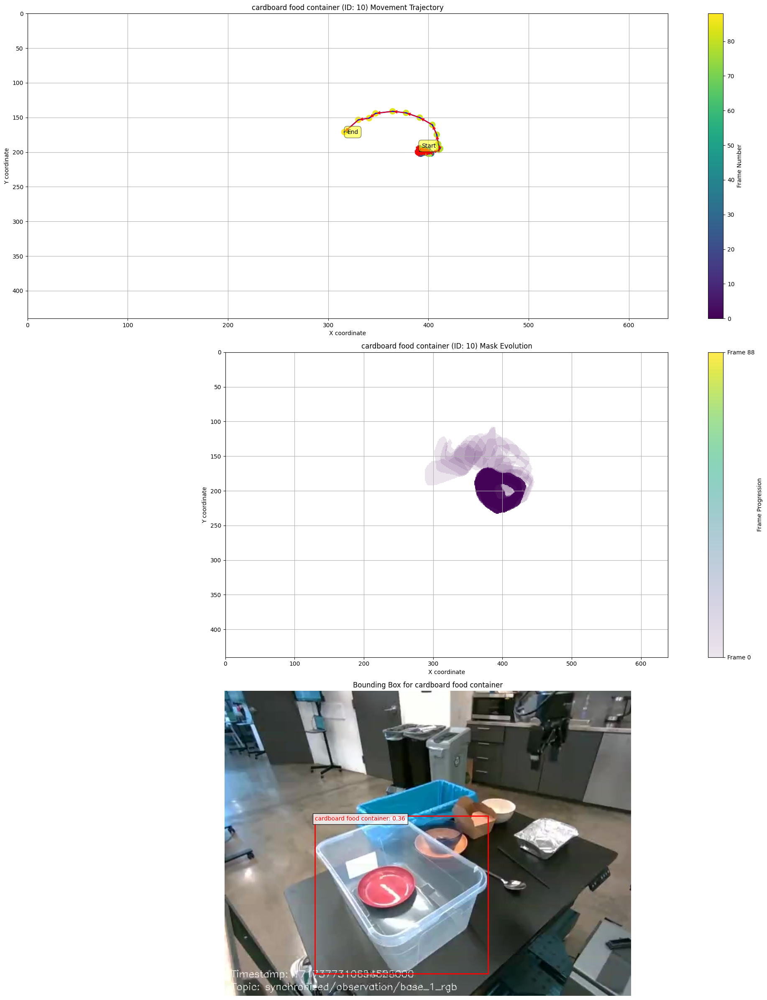


Movement and mask evolution summary for cardboard food container (ID: 10):
First appearance: Frame 0
Last appearance: Frame 88
Total frames: 89
Total distance moved: 212.86 pixels


In [44]:
import numpy as np
import matplotlib.pyplot as plt
import json
from matplotlib.colors import ListedColormap
from matplotlib.patches import Polygon, Rectangle
from PIL import Image

# Load the mask coordinates
with open('mask_coordinates.json', 'r') as f:
    mask_coordinates = json.load(f)

# Convert string keys to integers
mask_coordinates = {int(k): {int(k2): np.array(v2) for k2, v2 in v.items()} 
                    for k, v in mask_coordinates.items()}

# Get unique object IDs
object_ids = set(obj_id for frame in mask_coordinates.values() for obj_id in frame)

# Assuming you have run the DetectionTask and have these variables
# input_boxes, class_names, confidences

# Convert input_boxes to the format [x, y, width, height]
boxes_for_plot = []
for box in input_boxes:
    x1, y1, x2, y2 = box
    width = x2 - x1
    height = y2 - y1
    boxes_for_plot.append([x1, y1, width, height])

# Create ID_TO_OBJECTS dictionary
ID_TO_OBJECTS = {i+1: obj for i, obj in enumerate(class_names)}

def get_centroid(coords):
    """Calculate the centroid of the coordinates."""
    if coords.size == 0:  # Handle empty array
        return None
    if coords.ndim == 1:  # Handle 1D array
        return coords[1:] if len(coords) > 2 else None
    return np.mean(coords[:, 1:], axis=0)  # For 2D array, ignore the first column (always 0)

# Determine the original image dimensions
max_y = max_x = 0
for frame in mask_coordinates.values():
    for obj in frame.values():
        if obj.size > 0:
            max_y = max(max_y, np.max(obj[:, 1]))
            max_x = max(max_x, np.max(obj[:, 2]))

def create_mask_image(coords, shape):
    mask = np.zeros(shape, dtype=np.uint8)
    if coords.size > 0:
        coords = coords[:, 1:]  # Remove the first column if it's all zeros
        rr, cc = coords[:, 0], coords[:, 1]
        mask[rr, cc] = 1
    return mask

def plot_image_with_box(ax, image, box, class_name, confidence):
    # Display the image
    ax.imshow(image)
    
    # Create a Rectangle patch for the box
    x, y, w, h = box
    rect = Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
    
    # Add the patch to the Axes
    ax.add_patch(rect)
    
    # Add label
    ax.text(x, y, f'{class_name}: {confidence:.2f}', 
            bbox=dict(facecolor='white', alpha=0.8),
            verticalalignment='top', color='red')
    
    ax.set_title(f'Bounding Box for {class_name}')
    ax.axis('off')

# Load the image once
image = Image.open(img_path)

# Main visualization loop
for obj_id in object_ids:
    object_coords = {}
    for frame in sorted(mask_coordinates.keys()):
        if obj_id in mask_coordinates[frame]:
            centroid = get_centroid(mask_coordinates[frame][obj_id])
            if centroid is not None:
                object_coords[frame] = centroid

    if not object_coords:
        print(f"No valid coordinates for {ID_TO_OBJECTS.get(obj_id, f'Unknown Object')} (ID: {obj_id})")
        continue

    # Extract x and y coordinates
    frames = list(object_coords.keys())
    y_coords = [coord[0] for coord in object_coords.values()]
    x_coords = [coord[1] for coord in object_coords.values()]

    # Create a figure with three subplots
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 24))
    
    # Plot trajectory on the first subplot
    ax1.plot(x_coords, y_coords, 'b-', linewidth=2)
    scatter = ax1.scatter(x_coords, y_coords, c=frames, cmap='viridis', s=100)
    
    # Add arrows to show direction
    for i in range(1, len(frames)):
        ax1.annotate('', xy=(x_coords[i], y_coords[i]), xytext=(x_coords[i-1], y_coords[i-1]),
                     arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    # Annotate start and end points
    ax1.annotate('Start', xy=(x_coords[0], y_coords[0]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='bottom',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))
    ax1.annotate('End', xy=(x_coords[-1], y_coords[-1]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='top',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

    plt.colorbar(scatter, ax=ax1, label='Frame Number')
    ax1.set_title(f'{ID_TO_OBJECTS.get(obj_id, "Unknown Object")} (ID: {obj_id}) Movement Trajectory')    
    ax1.set_xlabel('X coordinate')
    ax1.set_ylabel('Y coordinate')
    ax1.set_xlim(0, max_x)
    ax1.set_ylim(max_y, 0)  # Invert y-axis to match image coordinates
    ax1.grid(True)

    # Plot mask evolution on the second subplot
    ax2.set_xlim(0, max_x)
    ax2.set_ylim(max_y, 0)  # Invert y-axis to match image coordinates
    ax2.set_title(f'{ID_TO_OBJECTS.get(obj_id, "Unknown Object")} (ID: {obj_id}) Mask Evolution')
    ax2.set_xlabel('X coordinate')
    ax2.set_ylabel('Y coordinate')

    # Create a colormap that transitions from transparent to solid
    n_frames = len(frames)
    colors = plt.cm.viridis(np.linspace(0, 1, n_frames))
    colors[:, 3] = np.linspace(0.1, 0.8, n_frames)  # Adjust alpha values
    custom_cmap = ListedColormap(colors)

    # Plot masks for each frame
    for i, frame in enumerate(frames):
        coords = mask_coordinates[frame][obj_id]
        mask = create_mask_image(coords, (max_y+1, max_x+1))
        ax2.imshow(mask, cmap=custom_cmap, alpha=mask, vmin=0, vmax=n_frames, extent=[0, max_x, max_y, 0])

    # Add a colorbar for the mask evolution
    sm = plt.cm.ScalarMappable(cmap=custom_cmap, norm=plt.Normalize(vmin=0, vmax=n_frames-1))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax2, label='Frame Progression')
    cbar.set_ticks([0, n_frames-1])
    cbar.set_ticklabels([f'Frame {frames[0]}', f'Frame {frames[-1]}'])

    ax2.grid(True)

    # Plot bounding box on the third subplot
    try:
        obj_index = class_names.index(ID_TO_OBJECTS[obj_id])
        box = boxes_for_plot[obj_index]
        class_name = class_names[obj_index]
        confidence = confidences[obj_index]
        plot_image_with_box(ax3, image, box, class_name, confidence)
    except ValueError:
        print(f"No bounding box found for object {obj_id}")
        ax3.text(0.5, 0.5, "No bounding box available", 
                 ha='center', va='center', transform=ax3.transAxes)
        ax3.axis('off')

    plt.tight_layout()
    plt.show()

    print(f"\nMovement and mask evolution summary for {ID_TO_OBJECTS.get(obj_id, 'Unknown Object')} (ID: {obj_id}):")
    print(f"First appearance: Frame {frames[0]}")
    print(f"Last appearance: Frame {frames[-1]}")
    print(f"Total frames: {len(frames)}")

    # Calculate total distance moved
    total_distance = np.sum([np.sqrt((x_coords[i]-x_coords[i-1])**2 + (y_coords[i]-y_coords[i-1])**2) 
                             for i in range(1, len(frames))])
    print(f"Total distance moved: {total_distance:.2f} pixels")

    # Uncomment these lines if you want detailed movement summary
    # for i in range(1, len(frames)):
    #     dx = x_coords[i] - x_coords[i-1]
    #     dy = y_coords[i] - y_coords[i-1]
    #     distance = np.sqrt(dx**2 + dy**2)
    #     print(f"From frame {frames[i-1]} to {frames[i]}: Moved {distance:.2f} pixels")
    #     if abs(dx) > abs(dy):
    #         print(f"  Primarily {'rightward' if dx > 0 else 'leftward'} movement")
    #     else:
    #         print(f"  Primarily {'downward' if dy > 0 else 'upward'} movement")")

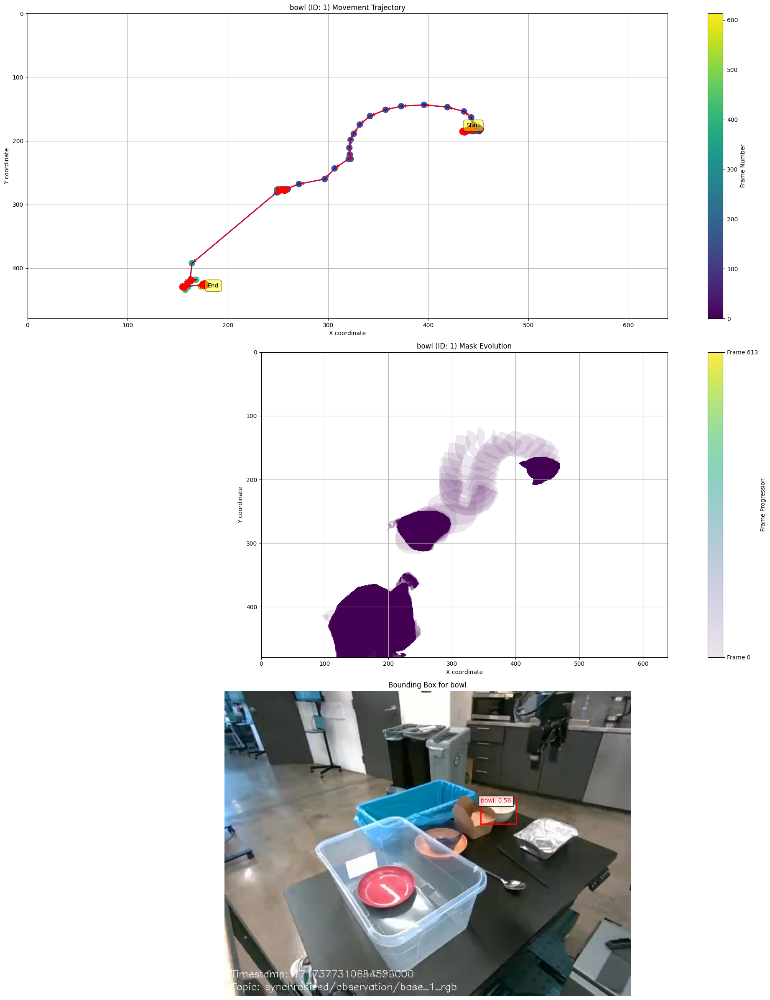


Movement and mask evolution summary for bowl (ID: 1):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 614
Total distance moved: 833.82 pixels
From frame 0 to 1: Moved 0.11 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.27 pixels
  Primarily upward movement
From frame 2 to 3: Moved 0.24 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.04 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.04 pixels
  Primarily downward movement
From frame 6 to 7: Moved 0.04 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.03 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.13 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.21 pixels
  Primarily downward movement
From frame 10 to 11: Moved 0.69 pixels
  Primarily downward movement
From frame 11 to 12: Moved 1.22 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.

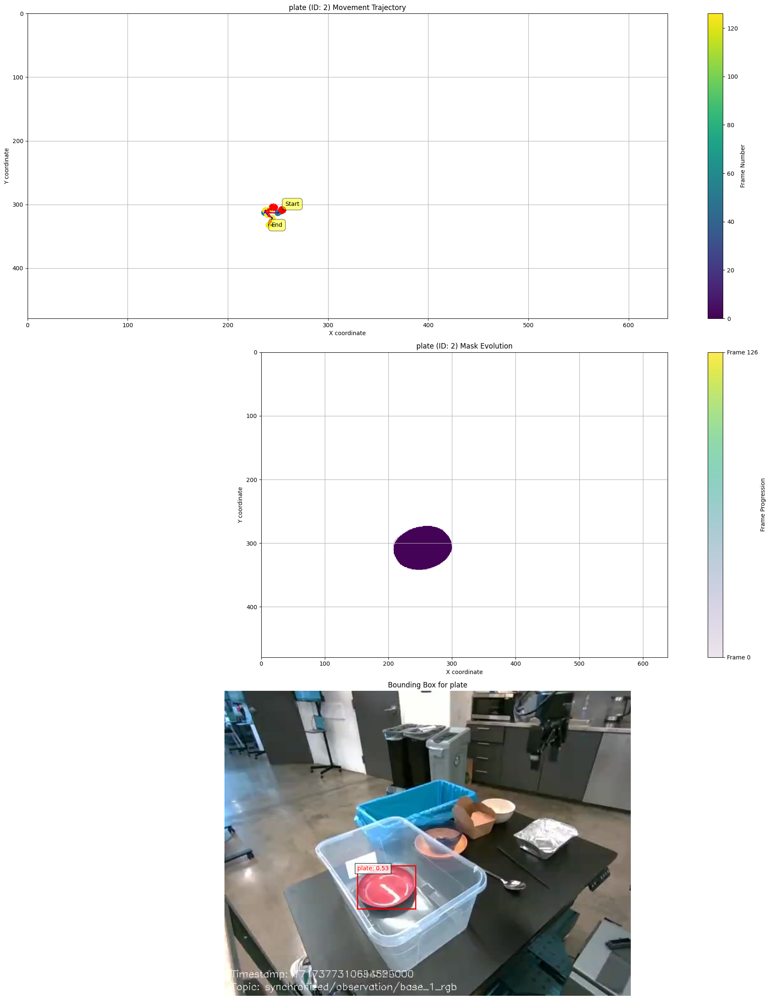


Movement and mask evolution summary for plate (ID: 2):
First appearance: Frame 0
Last appearance: Frame 126
Total frames: 127
Total distance moved: 85.69 pixels
From frame 0 to 1: Moved 0.05 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.25 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.01 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.04 pixels
  Primarily downward movement
From frame 4 to 5: Moved 0.03 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.03 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.05 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.05 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.01 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.03 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.43 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.06 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0.00

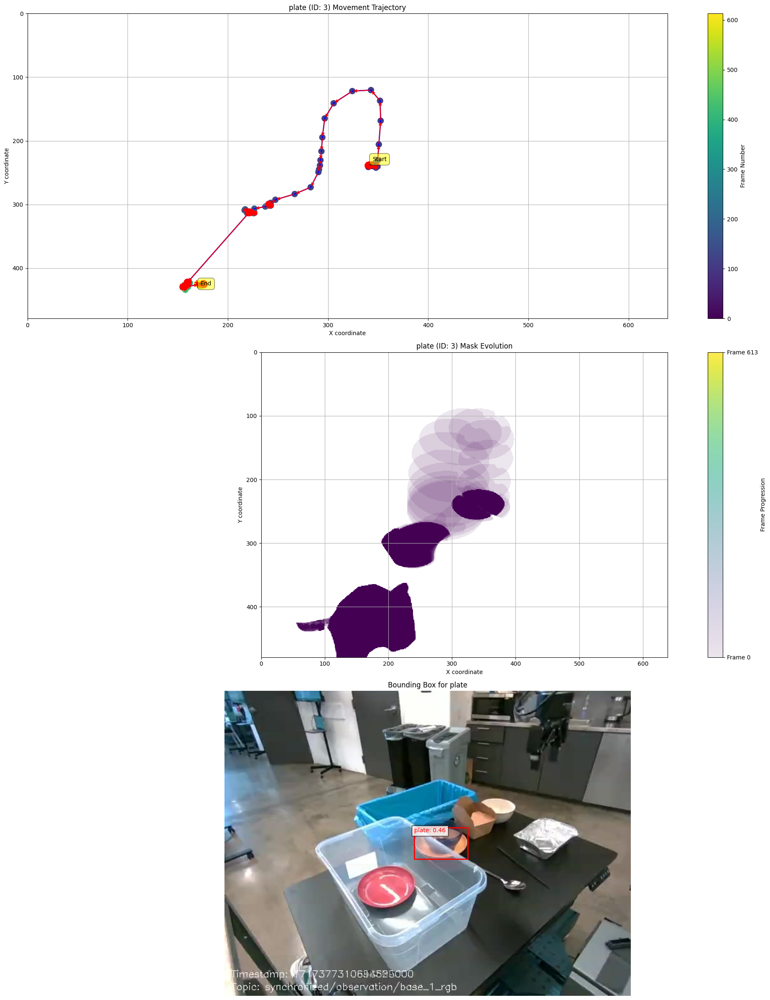


Movement and mask evolution summary for plate (ID: 3):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 614
Total distance moved: 746.04 pixels
From frame 0 to 1: Moved 0.65 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.12 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.13 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.06 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.08 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.01 pixels
  Primarily downward movement
From frame 7 to 8: Moved 0.06 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.19 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.20 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.11 pixels
  Primarily downward movement
From frame 12 to 13: Moved 

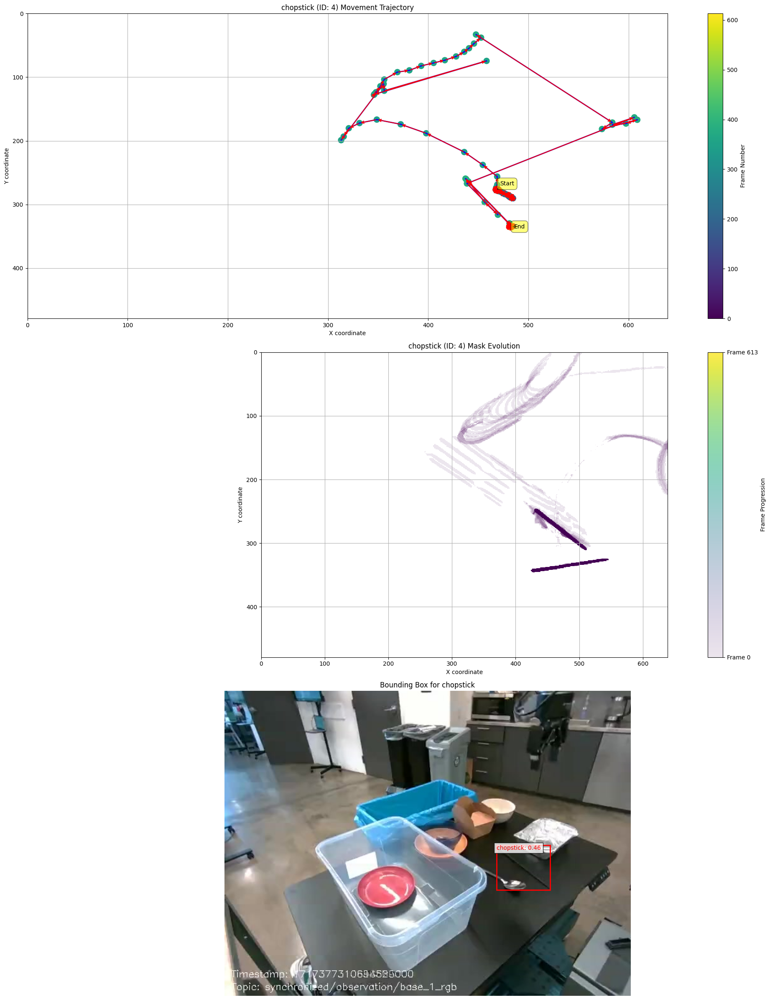


Movement and mask evolution summary for chopstick (ID: 4):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 614
Total distance moved: 1853.96 pixels
From frame 0 to 1: Moved 0.34 pixels
  Primarily downward movement
From frame 1 to 2: Moved 0.63 pixels
  Primarily rightward movement
From frame 2 to 3: Moved 0.09 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.18 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.23 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.33 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.13 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.10 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.09 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.09 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.06 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.07 pixels
  Primarily rightward movement
From frame 12 to 13:

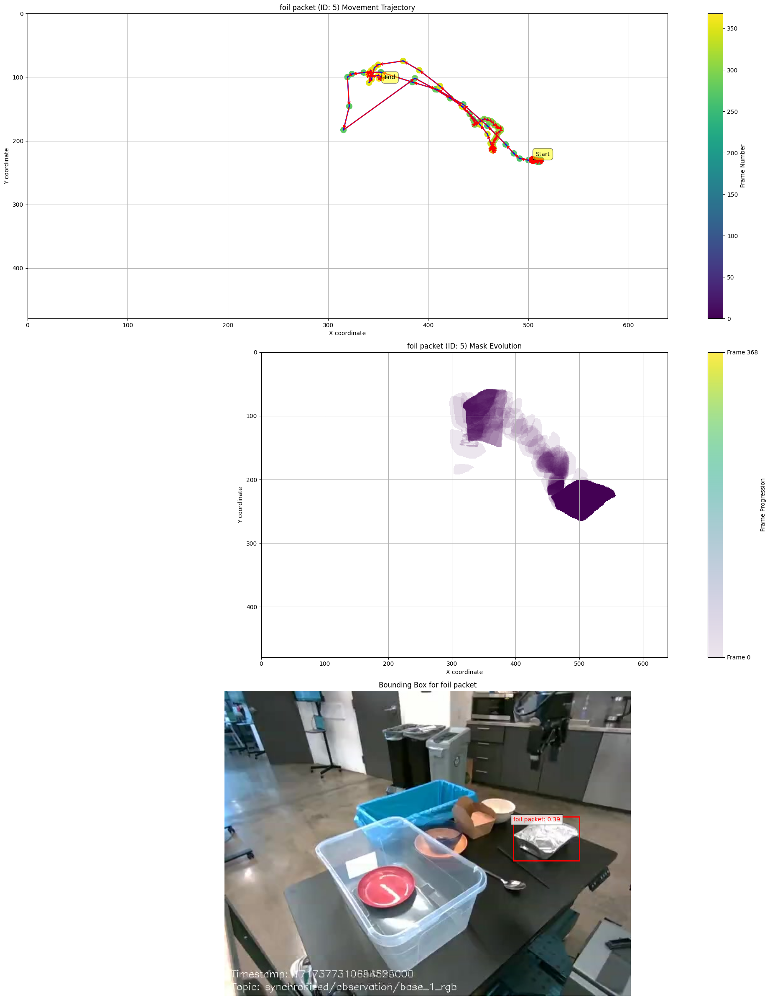


Movement and mask evolution summary for foil packet (ID: 5):
First appearance: Frame 0
Last appearance: Frame 368
Total frames: 365
Total distance moved: 933.16 pixels
From frame 0 to 1: Moved 0.24 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.02 pixels
  Primarily rightward movement
From frame 2 to 3: Moved 0.01 pixels
  Primarily rightward movement
From frame 3 to 4: Moved 0.01 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.05 pixels
  Primarily rightward movement
From frame 5 to 6: Moved 0.04 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.03 pixels
  Primarily leftward movement
From frame 7 to 8: Moved 0.01 pixels
  Primarily downward movement
From frame 8 to 9: Moved 0.01 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.02 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.08 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.08 pixels
  Primarily leftward movement
From frame 12 to 

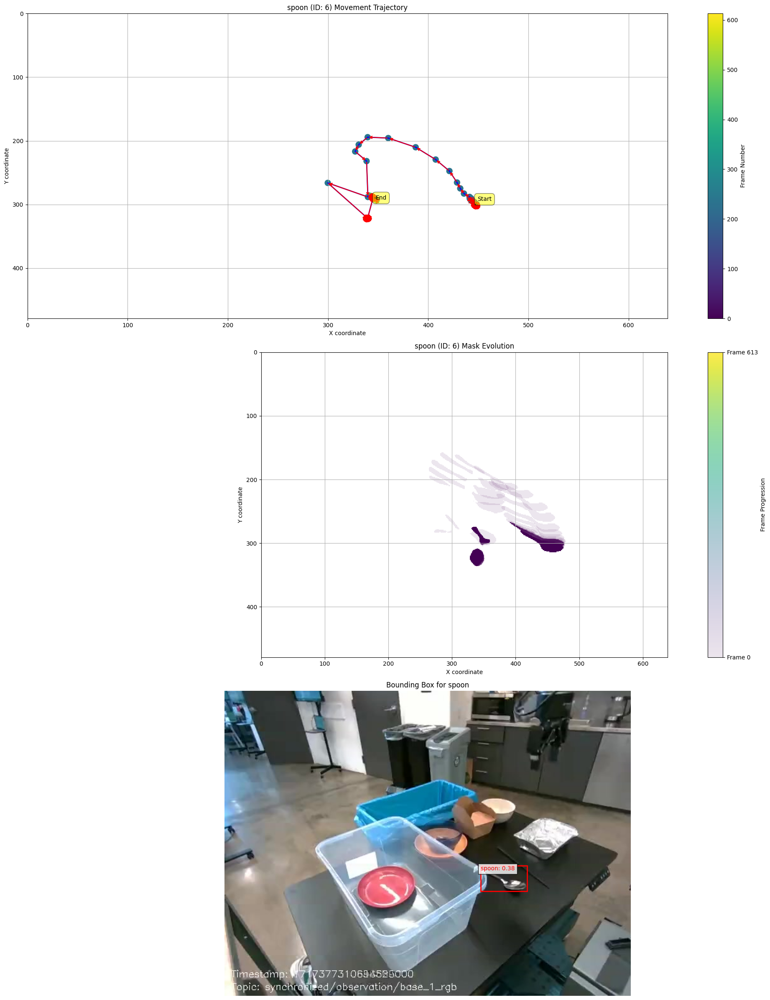


Movement and mask evolution summary for spoon (ID: 6):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 614
Total distance moved: 545.17 pixels
From frame 0 to 1: Moved 0.16 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.01 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.06 pixels
  Primarily upward movement
From frame 4 to 5: Moved 0.06 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.42 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.15 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.09 pixels
  Primarily rightward movement
From frame 8 to 9: Moved 0.08 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.16 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.01 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.02 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.

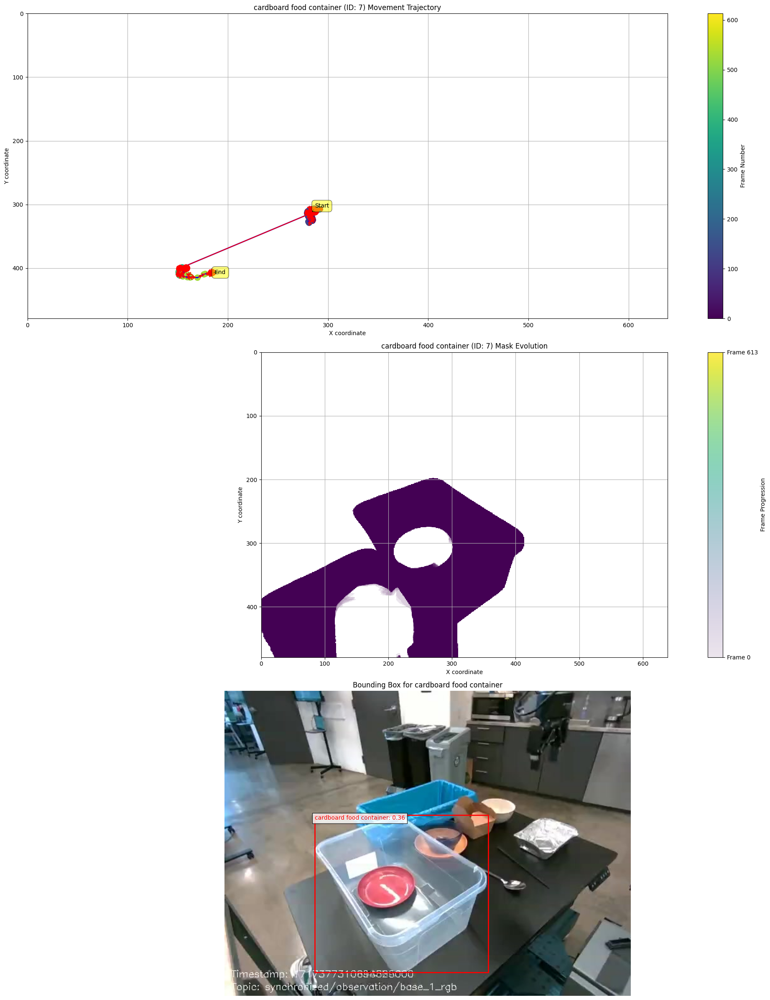


Movement and mask evolution summary for cardboard food container (ID: 7):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 614
Total distance moved: 462.14 pixels
From frame 0 to 1: Moved 0.24 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.04 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.22 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.09 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.04 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.06 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.01 pixels
  Primarily leftward movement
From frame 7 to 8: Moved 0.04 pixels
  Primarily upward movement
From frame 8 to 9: Moved 0.21 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.04 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.05 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.08 pixels
  Primarily downward movement
From frame 12

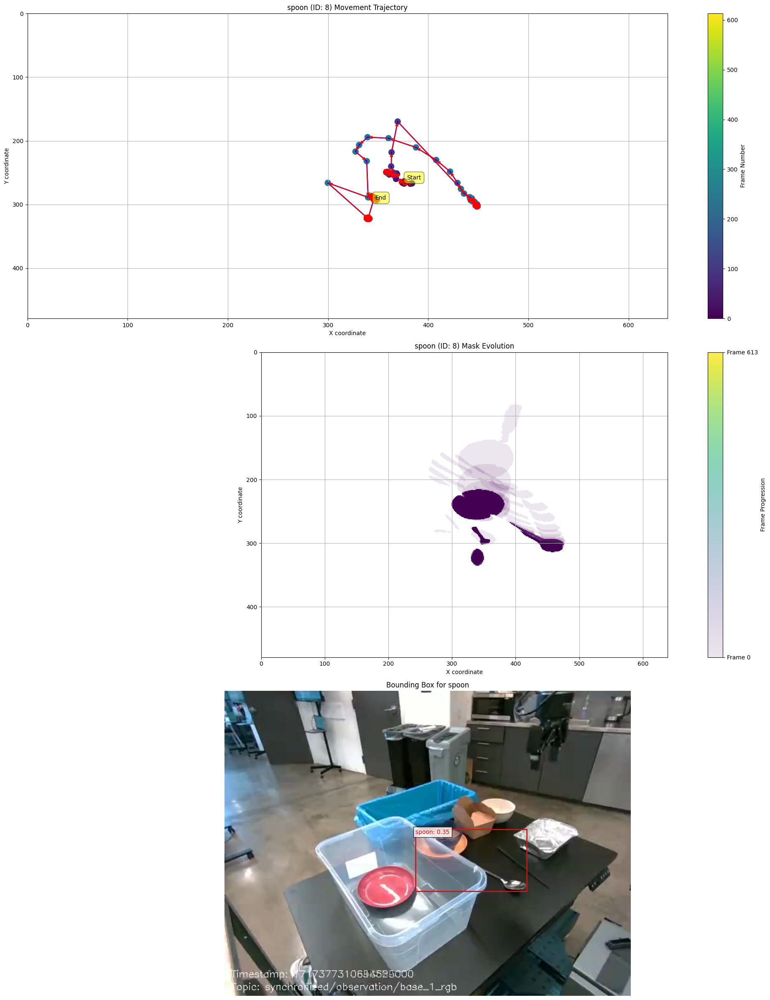


Movement and mask evolution summary for spoon (ID: 8):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 614
Total distance moved: 874.66 pixels
From frame 0 to 1: Moved 1.70 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.09 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.04 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.26 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.01 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.10 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.30 pixels
  Primarily leftward movement
From frame 7 to 8: Moved 0.11 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.20 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 1.06 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.53 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.12 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 

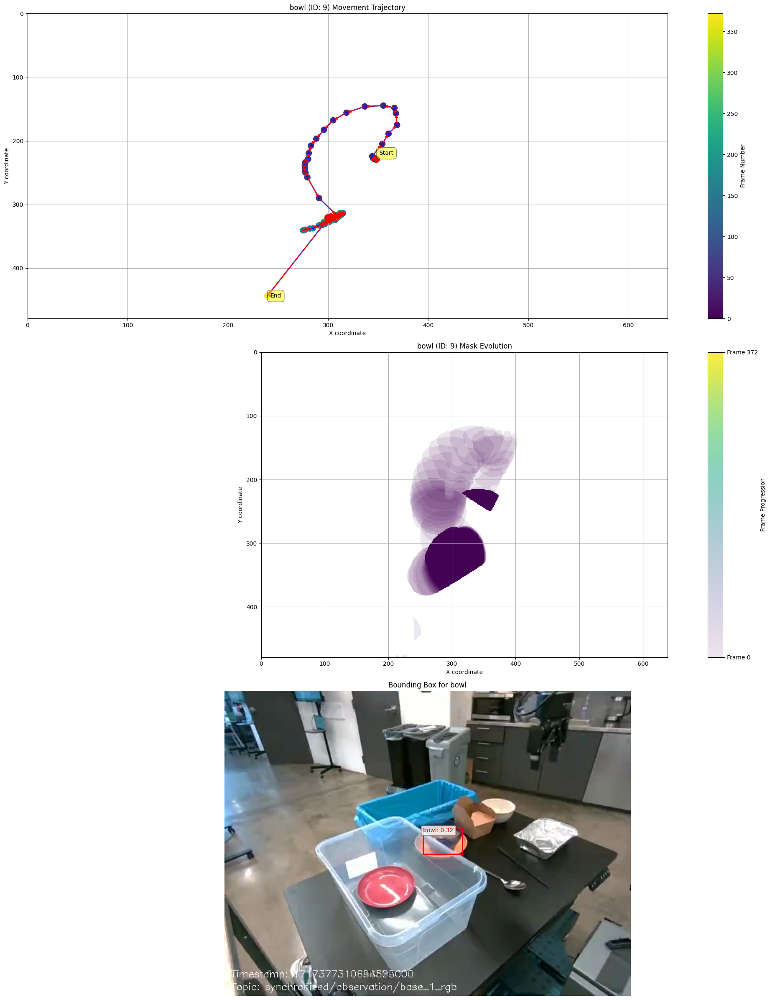


Movement and mask evolution summary for bowl (ID: 9):
First appearance: Frame 0
Last appearance: Frame 372
Total frames: 373
Total distance moved: 915.87 pixels
From frame 0 to 1: Moved 0.39 pixels
  Primarily leftward movement
From frame 1 to 2: Moved 0.18 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.02 pixels
  Primarily downward movement
From frame 3 to 4: Moved 0.13 pixels
  Primarily upward movement
From frame 4 to 5: Moved 0.08 pixels
  Primarily leftward movement
From frame 5 to 6: Moved 0.14 pixels
  Primarily leftward movement
From frame 6 to 7: Moved 0.07 pixels
  Primarily upward movement
From frame 7 to 8: Moved 0.08 pixels
  Primarily rightward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily downward movement
From frame 9 to 10: Moved 0.08 pixels
  Primarily rightward movement
From frame 10 to 11: Moved 0.03 pixels
  Primarily rightward movement
From frame 11 to 12: Moved 0.05 pixels
  Primarily leftward movement
From frame 12 to 13: Moved 0.0

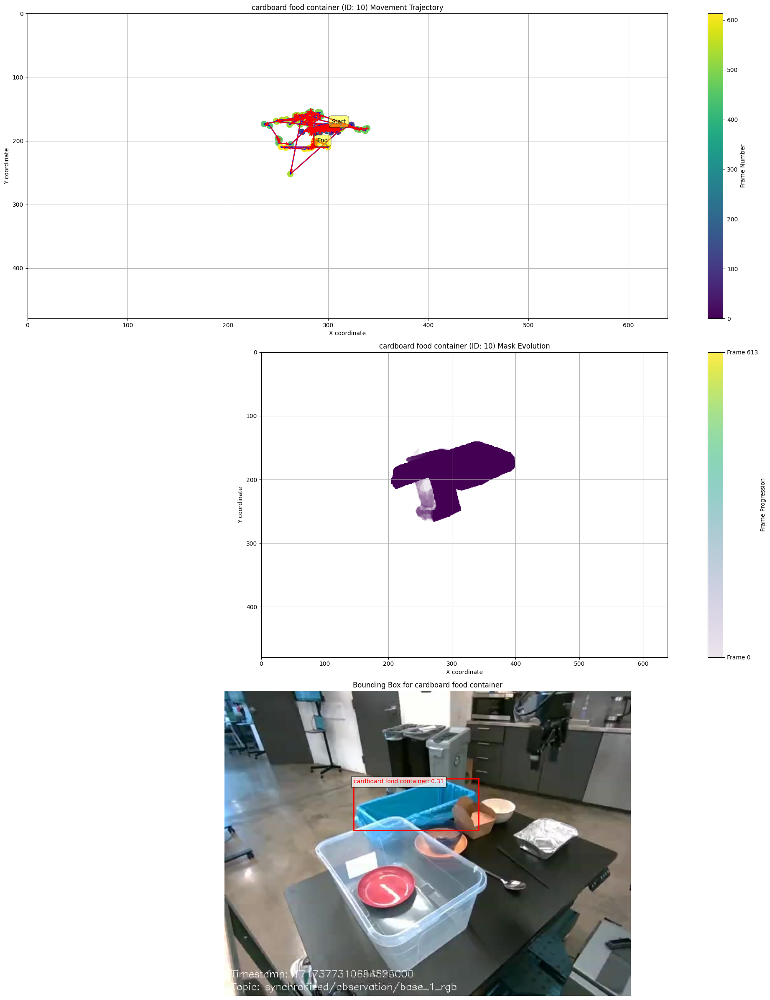


Movement and mask evolution summary for cardboard food container (ID: 10):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 544
Total distance moved: 1680.43 pixels
From frame 0 to 1: Moved 0.18 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.44 pixels
  Primarily downward movement
From frame 2 to 3: Moved 0.03 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.44 pixels
  Primarily upward movement
From frame 4 to 5: Moved 0.35 pixels
  Primarily downward movement
From frame 5 to 6: Moved 0.04 pixels
  Primarily rightward movement
From frame 6 to 7: Moved 0.05 pixels
  Primarily downward movement
From frame 7 to 8: Moved 0.06 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.02 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.01 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.03 pixels
  Primarily downward movement
From frame 11 to 12: Moved 0.02 pixels
  Primarily upward movement
From frame 

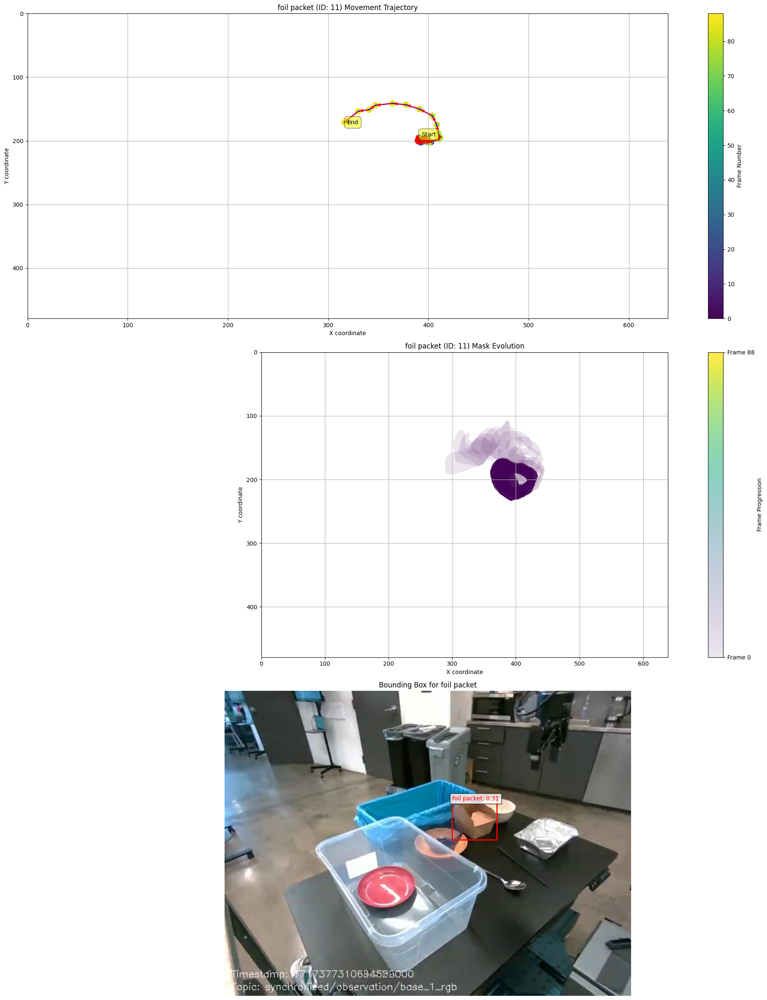


Movement and mask evolution summary for foil packet (ID: 11):
First appearance: Frame 0
Last appearance: Frame 88
Total frames: 89
Total distance moved: 212.97 pixels
From frame 0 to 1: Moved 0.18 pixels
  Primarily downward movement
From frame 1 to 2: Moved 0.06 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.06 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.04 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.00 pixels
  Primarily upward movement
From frame 5 to 6: Moved 0.04 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.09 pixels
  Primarily rightward movement
From frame 7 to 8: Moved 0.02 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.04 pixels
  Primarily upward movement
From frame 9 to 10: Moved 0.05 pixels
  Primarily leftward movement
From frame 10 to 11: Moved 0.04 pixels
  Primarily upward movement
From frame 11 to 12: Moved 0.11 pixels
  Primarily rightward movement
From frame 12 to 13: Moved 0.8

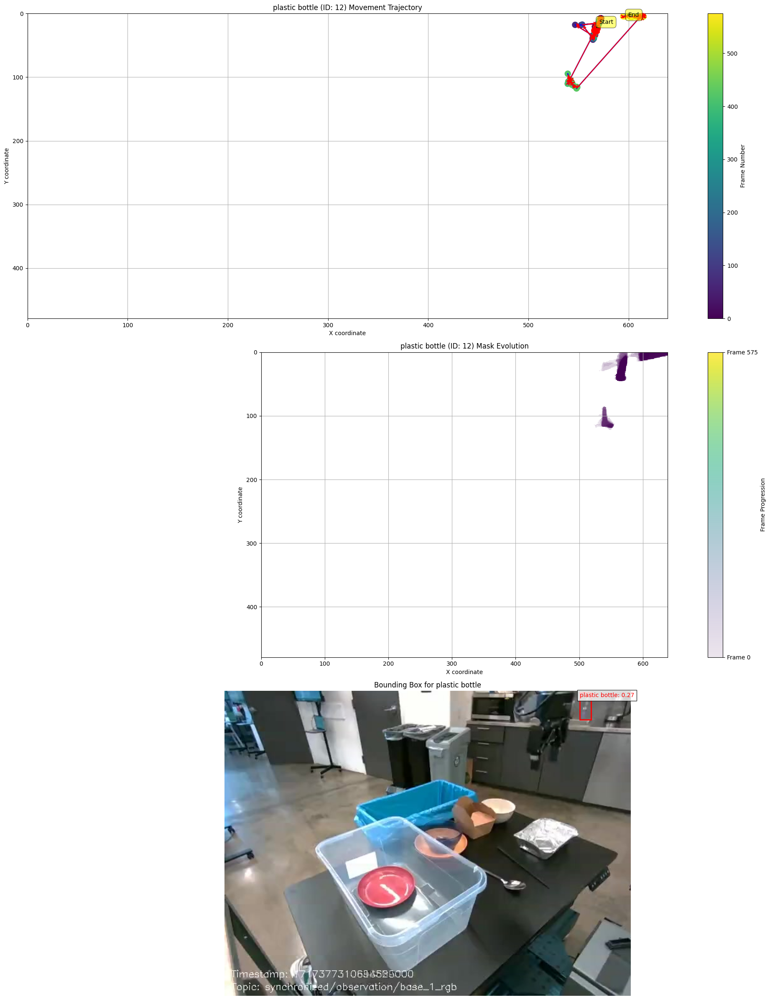


Movement and mask evolution summary for plastic bottle (ID: 12):
First appearance: Frame 0
Last appearance: Frame 575
Total frames: 342
Total distance moved: 974.21 pixels
From frame 0 to 1: Moved 0.54 pixels
  Primarily upward movement
From frame 1 to 2: Moved 0.69 pixels
  Primarily upward movement
From frame 2 to 3: Moved 0.42 pixels
  Primarily leftward movement
From frame 3 to 4: Moved 0.09 pixels
  Primarily leftward movement
From frame 4 to 5: Moved 0.48 pixels
  Primarily upward movement
From frame 5 to 6: Moved 1.07 pixels
  Primarily downward movement
From frame 6 to 7: Moved 0.08 pixels
  Primarily upward movement
From frame 7 to 8: Moved 12.27 pixels
  Primarily downward movement
From frame 8 to 14: Moved 27.35 pixels
  Primarily upward movement
From frame 14 to 15: Moved 0.63 pixels
  Primarily leftward movement
From frame 15 to 16: Moved 0.24 pixels
  Primarily rightward movement
From frame 16 to 17: Moved 0.90 pixels
  Primarily downward movement
From frame 17 to 18: Mo

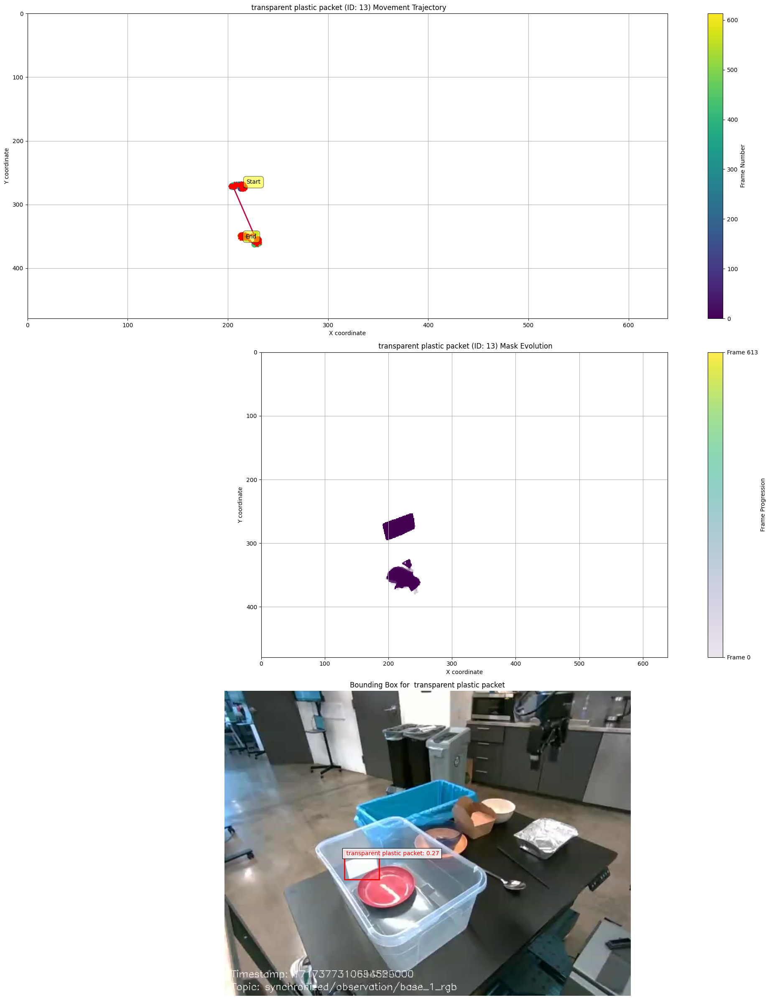


Movement and mask evolution summary for  transparent plastic packet (ID: 13):
First appearance: Frame 0
Last appearance: Frame 613
Total frames: 613
Total distance moved: 480.16 pixels
From frame 0 to 1: Moved 0.07 pixels
  Primarily rightward movement
From frame 1 to 2: Moved 0.18 pixels
  Primarily leftward movement
From frame 2 to 3: Moved 0.00 pixels
  Primarily upward movement
From frame 3 to 4: Moved 0.18 pixels
  Primarily rightward movement
From frame 4 to 5: Moved 0.02 pixels
  Primarily rightward movement
From frame 5 to 6: Moved 0.02 pixels
  Primarily upward movement
From frame 6 to 7: Moved 0.07 pixels
  Primarily downward movement
From frame 7 to 8: Moved 0.02 pixels
  Primarily leftward movement
From frame 8 to 9: Moved 0.04 pixels
  Primarily rightward movement
From frame 9 to 10: Moved 0.05 pixels
  Primarily upward movement
From frame 10 to 11: Moved 0.06 pixels
  Primarily leftward movement
From frame 11 to 12: Moved 0.06 pixels
  Primarily upward movement
From fram

In [70]:
import numpy as np
import matplotlib.pyplot as plt
import json
from matplotlib.colors import ListedColormap
from matplotlib.patches import Polygon, Rectangle
from PIL import Image

# Load the mask coordinates
with open('mask_coordinates.json', 'r') as f:
    mask_coordinates = json.load(f)

# Convert string keys to integers
mask_coordinates = {int(k): {int(k2): np.array(v2) for k2, v2 in v.items()} 
                    for k, v in mask_coordinates.items()}

# Get unique object IDs
object_ids = set(obj_id for frame in mask_coordinates.values() for obj_id in frame)

# Assuming you have run the DetectionTask and have these variables
# input_boxes, class_names, confidences

# Convert input_boxes to the format [x, y, width, height]
boxes_for_plot = []
for box in input_boxes:
    x1, y1, x2, y2 = box
    width = x2 - x1
    height = y2 - y1
    boxes_for_plot.append([x1, y1, width, height])

# Create ID_TO_OBJECTS dictionary
ID_TO_OBJECTS = {i+1: obj for i, obj in enumerate(class_names)}

# Create a mapping from object ID to its index in the detection results
id_to_detection_index = {}
for i, (box, class_name, confidence) in enumerate(zip(input_boxes, class_names, confidences)):
    # Find the object ID that corresponds to this detection
    for obj_id, obj_class in ID_TO_OBJECTS.items():
        if obj_class == class_name:
            if obj_id not in id_to_detection_index:
                id_to_detection_index[obj_id] = i
                break

def get_centroid(coords):
    """Calculate the centroid of the coordinates."""
    if coords.size == 0:  # Handle empty array
        return None
    if coords.ndim == 1:  # Handle 1D array
        return coords[1:] if len(coords) > 2 else None
    return np.mean(coords[:, 1:], axis=0)  # For 2D array, ignore the first column (always 0)

# Determine the original image dimensions
max_y = max_x = 0
for frame in mask_coordinates.values():
    for obj in frame.values():
        if obj.size > 0:
            max_y = max(max_y, np.max(obj[:, 1]))
            max_x = max(max_x, np.max(obj[:, 2]))

def create_mask_image(coords, shape):
    mask = np.zeros(shape, dtype=np.uint8)
    if coords.size > 0:
        coords = coords[:, 1:]  # Remove the first column if it's all zeros
        rr, cc = coords[:, 0], coords[:, 1]
        mask[rr, cc] = 1
    return mask

def plot_image_with_box(ax, image, box, class_name, confidence):
    # Display the image
    ax.imshow(image)
    
    # Create a Rectangle patch for the box
    x, y, w, h = box
    rect = Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
    
    # Add the patch to the Axes
    ax.add_patch(rect)
    
    # Add label
    ax.text(x, y, f'{class_name}: {confidence:.2f}', 
            bbox=dict(facecolor='white', alpha=0.8),
            verticalalignment='top', color='red')
    
    ax.set_title(f'Bounding Box for {class_name}')
    ax.axis('off')

# Load the image once
image = Image.open(img_path)

# Main visualization loop
for obj_id in object_ids:
    object_coords = {}
    for frame in sorted(mask_coordinates.keys()):
        if obj_id in mask_coordinates[frame]:
            centroid = get_centroid(mask_coordinates[frame][obj_id])
            if centroid is not None:
                object_coords[frame] = centroid

    if not object_coords:
        print(f"No valid coordinates for {ID_TO_OBJECTS.get(obj_id, f'Unknown Object')} (ID: {obj_id})")
        continue

    # Extract x and y coordinates
    frames = list(object_coords.keys())
    y_coords = [coord[0] for coord in object_coords.values()]
    x_coords = [coord[1] for coord in object_coords.values()]

    # Create a figure with three subplots
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 24))
    
    # Plot trajectory on the first subplot
    ax1.plot(x_coords, y_coords, 'b-', linewidth=2)
    scatter = ax1.scatter(x_coords, y_coords, c=frames, cmap='viridis', s=100)
    
    # Add arrows to show direction
    for i in range(1, len(frames)):
        ax1.annotate('', xy=(x_coords[i], y_coords[i]), xytext=(x_coords[i-1], y_coords[i-1]),
                     arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    # Annotate start and end points
    ax1.annotate('Start', xy=(x_coords[0], y_coords[0]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='bottom',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))
    ax1.annotate('End', xy=(x_coords[-1], y_coords[-1]), xytext=(5, 5), 
                 textcoords='offset points', ha='left', va='top',
                 bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                 arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

    plt.colorbar(scatter, ax=ax1, label='Frame Number')
    ax1.set_title(f'{ID_TO_OBJECTS.get(obj_id, "Unknown Object")} (ID: {obj_id}) Movement Trajectory')    
    ax1.set_xlabel('X coordinate')
    ax1.set_ylabel('Y coordinate')
    ax1.set_xlim(0, max_x)
    ax1.set_ylim(max_y, 0)  # Invert y-axis to match image coordinates
    ax1.grid(True)

    # Plot mask evolution on the second subplot
    ax2.set_xlim(0, max_x)
    ax2.set_ylim(max_y, 0)  # Invert y-axis to match image coordinates
    ax2.set_title(f'{ID_TO_OBJECTS.get(obj_id, "Unknown Object")} (ID: {obj_id}) Mask Evolution')
    ax2.set_xlabel('X coordinate')
    ax2.set_ylabel('Y coordinate')

    # Create a colormap that transitions from transparent to solid
    n_frames = len(frames)
    colors = plt.cm.viridis(np.linspace(0, 1, n_frames))
    colors[:, 3] = np.linspace(0.1, 0.8, n_frames)  # Adjust alpha values
    custom_cmap = ListedColormap(colors)

    # Plot masks for each frame
    for i, frame in enumerate(frames):
        coords = mask_coordinates[frame][obj_id]
        mask = create_mask_image(coords, (max_y+1, max_x+1))
        ax2.imshow(mask, cmap=custom_cmap, alpha=mask, vmin=0, vmax=n_frames, extent=[0, max_x, max_y, 0])

    # Add a colorbar for the mask evolution
    sm = plt.cm.ScalarMappable(cmap=custom_cmap, norm=plt.Normalize(vmin=0, vmax=n_frames-1))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax2, label='Frame Progression')
    cbar.set_ticks([0, n_frames-1])
    cbar.set_ticklabels([f'Frame {frames[0]}', f'Frame {frames[-1]}'])

    ax2.grid(True)

    # Plot bounding box on the third subplot
    if obj_id in id_to_detection_index:
        detection_index = id_to_detection_index[obj_id]
        box = boxes_for_plot[detection_index]
        class_name = class_names[detection_index]
        confidence = confidences[detection_index]
        plot_image_with_box(ax3, image, box, class_name, confidence)
    else:
        print(f"No bounding box found for object {obj_id}")
        ax3.text(0.5, 0.5, "No bounding box available", 
                 ha='center', va='center', transform=ax3.transAxes)
        ax3.axis('off')

    plt.tight_layout()
    plt.show()

    print(f"\nMovement and mask evolution summary for {ID_TO_OBJECTS.get(obj_id, 'Unknown Object')} (ID: {obj_id}):")
    print(f"First appearance: Frame {frames[0]}")
    print(f"Last appearance: Frame {frames[-1]}")
    print(f"Total frames: {len(frames)}")

    # Calculate total distance moved
    total_distance = np.sum([np.sqrt((x_coords[i]-x_coords[i-1])**2 + (y_coords[i]-y_coords[i-1])**2) 
                             for i in range(1, len(frames))])
    print(f"Total distance moved: {total_distance:.2f} pixels")

    # Uncomment these lines if you want detailed movement summary
    for i in range(1, len(frames)):
        dx = x_coords[i] - x_coords[i-1]
        dy = y_coords[i] - y_coords[i-1]
        distance = np.sqrt(dx**2 + dy**2)
        print(f"From frame {frames[i-1]} to {frames[i]}: Moved {distance:.2f} pixels")
        if abs(dx) > abs(dy):
            print(f"  Primarily {'rightward' if dx > 0 else 'leftward'} movement")
        else:
            print(f"  Primarily {'downward' if dy > 0 else 'upward'} movement")

# Step 6

In [10]:

"""
Step 6: Visualize the segment results across the video and save them
"""
save_dir = "./tracking_results_2"
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

ID_TO_OBJECTS = {i: obj for i, obj in enumerate(OBJECTS, start=1)}
for frame_idx, segments in video_segments.items():
    img = cv2.imread(os.path.join(video_dir, frame_names[frame_idx]))
    
    object_ids = list(segments.keys())
    masks = list(segments.values())
    masks = np.concatenate(masks, axis=0)
    
    detections = sv.Detections(
        xyxy=sv.mask_to_xyxy(masks),  # (n, 4)
        mask=masks, # (n, h, w)
        class_id=np.array(object_ids, dtype=np.int32),
    )
    box_annotator = sv.BoxAnnotator()
    annotated_frame = box_annotator.annotate(scene=img.copy(), detections=detections)
    label_annotator = sv.LabelAnnotator()
    annotated_frame = label_annotator.annotate(annotated_frame, detections=detections, labels=[ID_TO_OBJECTS[i] for i in object_ids])
    mask_annotator = sv.MaskAnnotator()
    annotated_frame = mask_annotator.annotate(scene=annotated_frame, detections=detections)
    cv2.imwrite(os.path.join(save_dir, f"annotated_frame_{frame_idx:05d}.jpg"), annotated_frame)
